# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [2]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [3]:
!mkdir data

Sottodirectory o file data già esistente.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:59, 3.05MB/s]                              
SVHN Testing Set: 64.3MB [00:34, 1.84MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

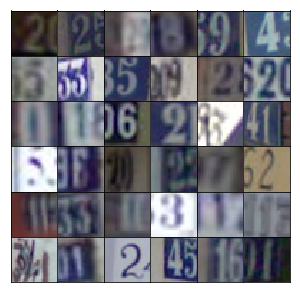

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [8]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [9]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [10]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [11]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [13]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [14]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [15]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [16]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [17]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [1]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [19]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2906... Generator Loss: 0.6829
Epoch 1/25... Discriminator Loss: 0.3577... Generator Loss: 2.0213
Epoch 1/25... Discriminator Loss: 0.1361... Generator Loss: 2.9781
Epoch 1/25... Discriminator Loss: 0.1153... Generator Loss: 3.1693
Epoch 1/25... Discriminator Loss: 0.1505... Generator Loss: 2.8408
Epoch 1/25... Discriminator Loss: 0.0757... Generator Loss: 3.2655
Epoch 1/25... Discriminator Loss: 0.1352... Generator Loss: 2.5745
Epoch 1/25... Discriminator Loss: 0.1016... Generator Loss: 3.3533
Epoch 1/25... Discriminator Loss: 0.1075... Generator Loss: 3.7244
Epoch 1/25... Discriminator Loss: 0.0778... Generator Loss: 4.3051


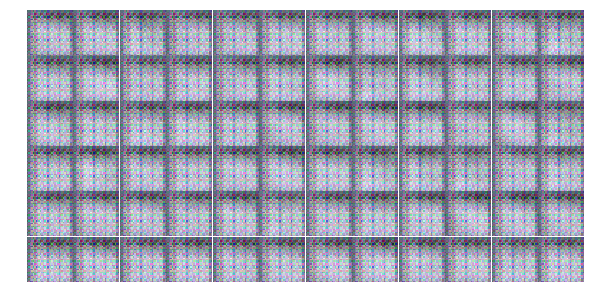

Epoch 1/25... Discriminator Loss: 0.1275... Generator Loss: 3.1778
Epoch 1/25... Discriminator Loss: 0.3246... Generator Loss: 2.1095
Epoch 1/25... Discriminator Loss: 0.7801... Generator Loss: 2.0657
Epoch 1/25... Discriminator Loss: 0.5264... Generator Loss: 1.6000
Epoch 1/25... Discriminator Loss: 0.6787... Generator Loss: 2.4494
Epoch 1/25... Discriminator Loss: 0.5235... Generator Loss: 1.6237
Epoch 1/25... Discriminator Loss: 0.3535... Generator Loss: 1.7864
Epoch 1/25... Discriminator Loss: 0.4983... Generator Loss: 3.4123
Epoch 1/25... Discriminator Loss: 0.3940... Generator Loss: 1.6449
Epoch 1/25... Discriminator Loss: 0.6738... Generator Loss: 3.4805


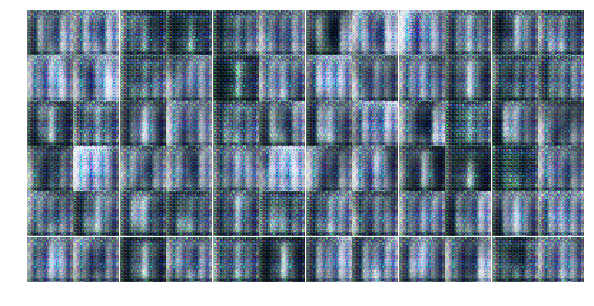

Epoch 1/25... Discriminator Loss: 0.4567... Generator Loss: 1.4263
Epoch 1/25... Discriminator Loss: 0.7075... Generator Loss: 0.9109
Epoch 1/25... Discriminator Loss: 1.1349... Generator Loss: 6.8729
Epoch 1/25... Discriminator Loss: 1.9395... Generator Loss: 0.5046
Epoch 1/25... Discriminator Loss: 0.6273... Generator Loss: 3.1587
Epoch 1/25... Discriminator Loss: 0.7373... Generator Loss: 0.8751
Epoch 1/25... Discriminator Loss: 0.2040... Generator Loss: 2.3358
Epoch 1/25... Discriminator Loss: 0.6528... Generator Loss: 3.3644
Epoch 1/25... Discriminator Loss: 0.3266... Generator Loss: 2.2091
Epoch 1/25... Discriminator Loss: 0.3317... Generator Loss: 1.8283


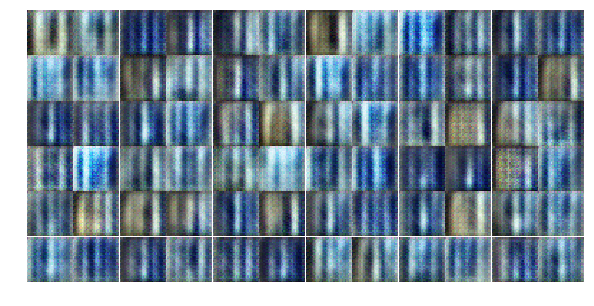

Epoch 1/25... Discriminator Loss: 0.3662... Generator Loss: 2.6088
Epoch 1/25... Discriminator Loss: 0.3545... Generator Loss: 2.1735
Epoch 1/25... Discriminator Loss: 0.4310... Generator Loss: 1.8727
Epoch 1/25... Discriminator Loss: 0.8135... Generator Loss: 0.9568
Epoch 1/25... Discriminator Loss: 1.2298... Generator Loss: 0.8722
Epoch 1/25... Discriminator Loss: 1.6907... Generator Loss: 3.4392
Epoch 1/25... Discriminator Loss: 1.0347... Generator Loss: 0.9835
Epoch 1/25... Discriminator Loss: 0.6877... Generator Loss: 1.7083
Epoch 1/25... Discriminator Loss: 0.6695... Generator Loss: 1.8983
Epoch 1/25... Discriminator Loss: 0.5135... Generator Loss: 1.7026


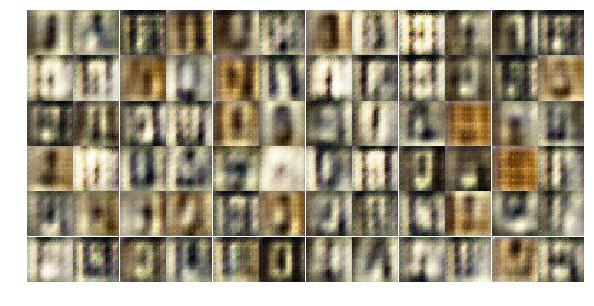

Epoch 1/25... Discriminator Loss: 0.4812... Generator Loss: 1.8650
Epoch 1/25... Discriminator Loss: 0.5669... Generator Loss: 1.4129
Epoch 1/25... Discriminator Loss: 0.7469... Generator Loss: 1.1430
Epoch 1/25... Discriminator Loss: 1.6309... Generator Loss: 0.4009
Epoch 1/25... Discriminator Loss: 0.6865... Generator Loss: 1.5953
Epoch 1/25... Discriminator Loss: 1.0237... Generator Loss: 0.8210
Epoch 1/25... Discriminator Loss: 0.7536... Generator Loss: 1.2135
Epoch 1/25... Discriminator Loss: 0.3353... Generator Loss: 1.7714
Epoch 1/25... Discriminator Loss: 0.8226... Generator Loss: 0.9320
Epoch 1/25... Discriminator Loss: 1.0149... Generator Loss: 1.4816


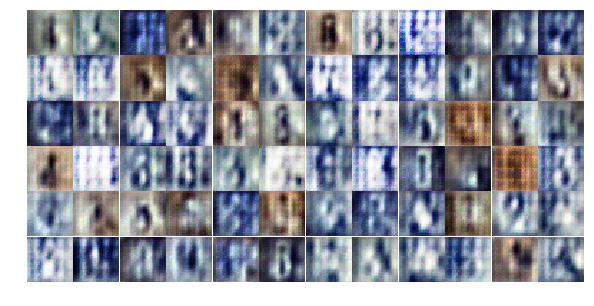

Epoch 1/25... Discriminator Loss: 0.8313... Generator Loss: 1.1102
Epoch 1/25... Discriminator Loss: 0.5692... Generator Loss: 1.9241
Epoch 1/25... Discriminator Loss: 0.5188... Generator Loss: 1.8589
Epoch 1/25... Discriminator Loss: 0.7258... Generator Loss: 1.1120
Epoch 1/25... Discriminator Loss: 0.5420... Generator Loss: 1.5481
Epoch 1/25... Discriminator Loss: 0.7143... Generator Loss: 1.6839
Epoch 1/25... Discriminator Loss: 0.8334... Generator Loss: 0.9349
Epoch 2/25... Discriminator Loss: 1.0451... Generator Loss: 1.0233
Epoch 2/25... Discriminator Loss: 0.5761... Generator Loss: 1.7696
Epoch 2/25... Discriminator Loss: 0.9137... Generator Loss: 1.1002


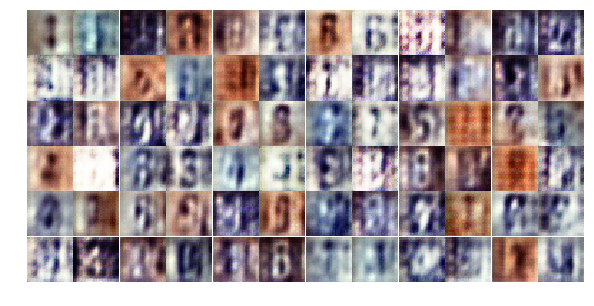

Epoch 2/25... Discriminator Loss: 0.8013... Generator Loss: 1.2913
Epoch 2/25... Discriminator Loss: 0.8736... Generator Loss: 1.5686
Epoch 2/25... Discriminator Loss: 0.9507... Generator Loss: 1.2715
Epoch 2/25... Discriminator Loss: 1.0807... Generator Loss: 0.8866
Epoch 2/25... Discriminator Loss: 0.6326... Generator Loss: 1.5297
Epoch 2/25... Discriminator Loss: 1.1172... Generator Loss: 1.6191
Epoch 2/25... Discriminator Loss: 0.4858... Generator Loss: 1.6701
Epoch 2/25... Discriminator Loss: 0.7894... Generator Loss: 1.2191
Epoch 2/25... Discriminator Loss: 0.8624... Generator Loss: 1.4126
Epoch 2/25... Discriminator Loss: 0.4381... Generator Loss: 1.6684


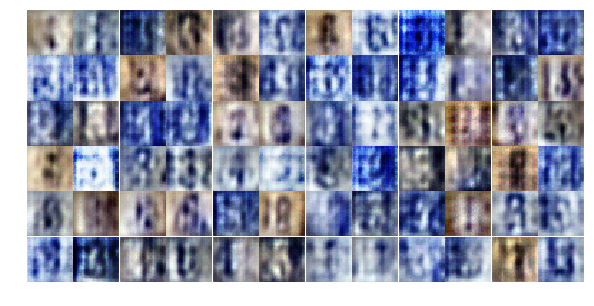

Epoch 2/25... Discriminator Loss: 0.5980... Generator Loss: 1.7622
Epoch 2/25... Discriminator Loss: 0.7529... Generator Loss: 2.0843
Epoch 2/25... Discriminator Loss: 0.7799... Generator Loss: 1.4268
Epoch 2/25... Discriminator Loss: 0.8048... Generator Loss: 1.2993
Epoch 2/25... Discriminator Loss: 0.8976... Generator Loss: 1.2417
Epoch 2/25... Discriminator Loss: 1.1795... Generator Loss: 0.7294
Epoch 2/25... Discriminator Loss: 1.4576... Generator Loss: 0.4357
Epoch 2/25... Discriminator Loss: 0.9868... Generator Loss: 1.1310
Epoch 2/25... Discriminator Loss: 1.0141... Generator Loss: 0.7625
Epoch 2/25... Discriminator Loss: 1.3577... Generator Loss: 0.4729


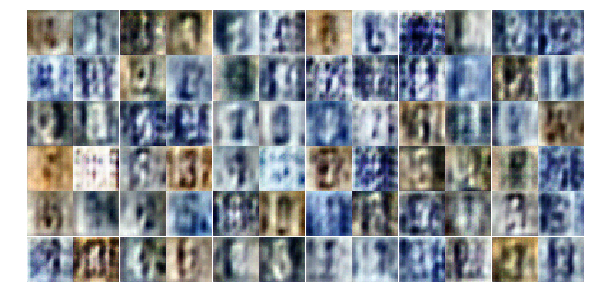

Epoch 2/25... Discriminator Loss: 0.9144... Generator Loss: 1.0751
Epoch 2/25... Discriminator Loss: 1.0913... Generator Loss: 0.9698
Epoch 2/25... Discriminator Loss: 0.8297... Generator Loss: 1.2541
Epoch 2/25... Discriminator Loss: 1.0303... Generator Loss: 1.5360
Epoch 2/25... Discriminator Loss: 0.9261... Generator Loss: 1.1770
Epoch 2/25... Discriminator Loss: 0.9973... Generator Loss: 0.8919
Epoch 2/25... Discriminator Loss: 0.7806... Generator Loss: 1.1213
Epoch 2/25... Discriminator Loss: 1.2722... Generator Loss: 0.7032
Epoch 2/25... Discriminator Loss: 1.0486... Generator Loss: 1.0544
Epoch 2/25... Discriminator Loss: 0.9177... Generator Loss: 0.9421


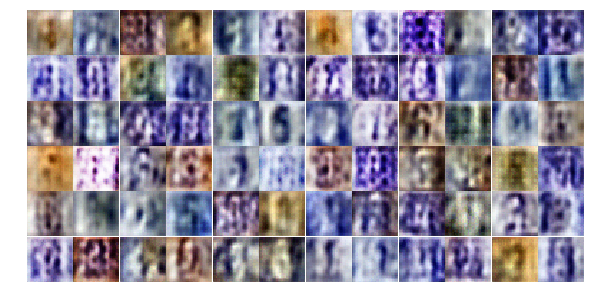

Epoch 2/25... Discriminator Loss: 1.0399... Generator Loss: 0.8819
Epoch 2/25... Discriminator Loss: 0.8654... Generator Loss: 1.1970
Epoch 2/25... Discriminator Loss: 1.6258... Generator Loss: 0.4275
Epoch 2/25... Discriminator Loss: 1.5981... Generator Loss: 0.4795
Epoch 2/25... Discriminator Loss: 1.2390... Generator Loss: 0.9589
Epoch 2/25... Discriminator Loss: 1.0944... Generator Loss: 0.9932
Epoch 2/25... Discriminator Loss: 1.0418... Generator Loss: 1.0094
Epoch 2/25... Discriminator Loss: 1.0748... Generator Loss: 1.0914
Epoch 2/25... Discriminator Loss: 1.1903... Generator Loss: 0.8575
Epoch 2/25... Discriminator Loss: 0.8512... Generator Loss: 1.2728


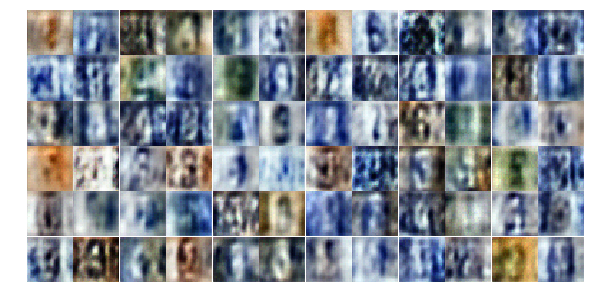

Epoch 2/25... Discriminator Loss: 1.0397... Generator Loss: 1.1442
Epoch 2/25... Discriminator Loss: 1.0353... Generator Loss: 1.3932
Epoch 2/25... Discriminator Loss: 0.8646... Generator Loss: 1.1746
Epoch 2/25... Discriminator Loss: 0.9251... Generator Loss: 1.1544
Epoch 2/25... Discriminator Loss: 1.0391... Generator Loss: 0.9669
Epoch 2/25... Discriminator Loss: 1.2723... Generator Loss: 0.6710
Epoch 2/25... Discriminator Loss: 1.0658... Generator Loss: 1.4549
Epoch 2/25... Discriminator Loss: 1.1012... Generator Loss: 0.8157
Epoch 2/25... Discriminator Loss: 0.8476... Generator Loss: 1.3085
Epoch 2/25... Discriminator Loss: 0.9486... Generator Loss: 1.0610


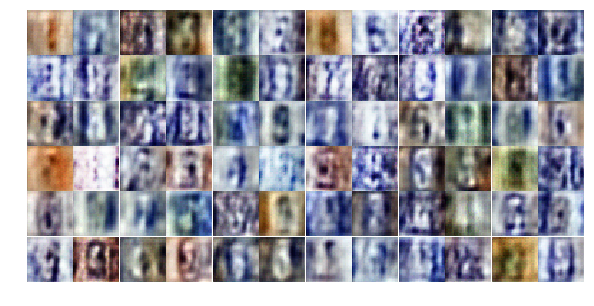

Epoch 2/25... Discriminator Loss: 0.8719... Generator Loss: 1.2524
Epoch 2/25... Discriminator Loss: 1.0610... Generator Loss: 0.7501
Epoch 2/25... Discriminator Loss: 0.8634... Generator Loss: 1.1479
Epoch 2/25... Discriminator Loss: 0.9575... Generator Loss: 1.0401
Epoch 3/25... Discriminator Loss: 0.7403... Generator Loss: 2.0806
Epoch 3/25... Discriminator Loss: 0.7571... Generator Loss: 1.3528
Epoch 3/25... Discriminator Loss: 0.8370... Generator Loss: 1.7829
Epoch 3/25... Discriminator Loss: 0.7457... Generator Loss: 0.8891
Epoch 3/25... Discriminator Loss: 0.8779... Generator Loss: 1.2152
Epoch 3/25... Discriminator Loss: 0.9055... Generator Loss: 1.2578


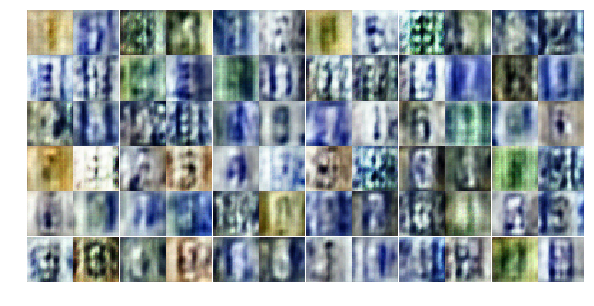

Epoch 3/25... Discriminator Loss: 0.8345... Generator Loss: 0.9238
Epoch 3/25... Discriminator Loss: 0.5757... Generator Loss: 1.3001
Epoch 3/25... Discriminator Loss: 0.5818... Generator Loss: 1.5132
Epoch 3/25... Discriminator Loss: 1.3006... Generator Loss: 2.2532
Epoch 3/25... Discriminator Loss: 0.7059... Generator Loss: 1.0960
Epoch 3/25... Discriminator Loss: 0.8160... Generator Loss: 0.9135
Epoch 3/25... Discriminator Loss: 0.6459... Generator Loss: 1.3022
Epoch 3/25... Discriminator Loss: 0.4133... Generator Loss: 1.6897
Epoch 3/25... Discriminator Loss: 1.2308... Generator Loss: 1.9901
Epoch 3/25... Discriminator Loss: 0.8255... Generator Loss: 1.0049


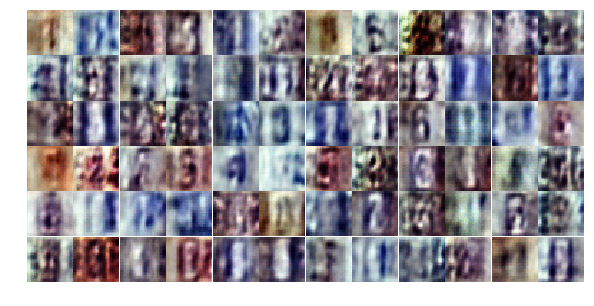

Epoch 3/25... Discriminator Loss: 1.1969... Generator Loss: 1.7522
Epoch 3/25... Discriminator Loss: 0.7847... Generator Loss: 1.0351
Epoch 3/25... Discriminator Loss: 1.3174... Generator Loss: 0.4903
Epoch 3/25... Discriminator Loss: 0.7434... Generator Loss: 1.1778
Epoch 3/25... Discriminator Loss: 0.5368... Generator Loss: 1.5275
Epoch 3/25... Discriminator Loss: 0.4287... Generator Loss: 1.9299
Epoch 3/25... Discriminator Loss: 1.2691... Generator Loss: 0.4894
Epoch 3/25... Discriminator Loss: 1.2126... Generator Loss: 2.4377
Epoch 3/25... Discriminator Loss: 0.4723... Generator Loss: 2.0265
Epoch 3/25... Discriminator Loss: 0.7227... Generator Loss: 1.1225


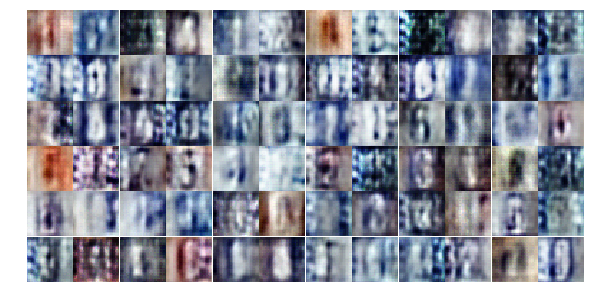

Epoch 3/25... Discriminator Loss: 0.5444... Generator Loss: 1.6627
Epoch 3/25... Discriminator Loss: 0.7931... Generator Loss: 1.0322
Epoch 3/25... Discriminator Loss: 0.9276... Generator Loss: 0.8676
Epoch 3/25... Discriminator Loss: 0.5159... Generator Loss: 1.4632
Epoch 3/25... Discriminator Loss: 0.7192... Generator Loss: 1.6068
Epoch 3/25... Discriminator Loss: 0.4648... Generator Loss: 1.6933
Epoch 3/25... Discriminator Loss: 0.6630... Generator Loss: 1.0011
Epoch 3/25... Discriminator Loss: 0.3420... Generator Loss: 1.9161
Epoch 3/25... Discriminator Loss: 1.1609... Generator Loss: 0.8113
Epoch 3/25... Discriminator Loss: 1.3665... Generator Loss: 0.4819


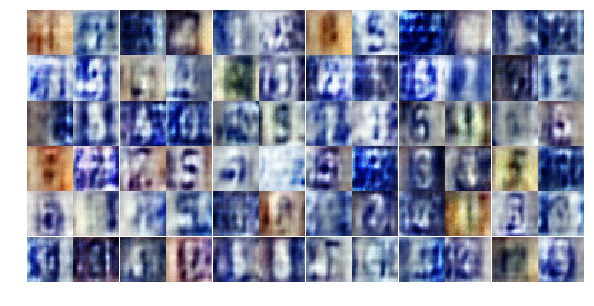

Epoch 3/25... Discriminator Loss: 0.6964... Generator Loss: 1.3530
Epoch 3/25... Discriminator Loss: 0.8738... Generator Loss: 2.0769
Epoch 3/25... Discriminator Loss: 0.6255... Generator Loss: 1.5364
Epoch 3/25... Discriminator Loss: 0.4670... Generator Loss: 1.6411
Epoch 3/25... Discriminator Loss: 0.3775... Generator Loss: 2.1552
Epoch 3/25... Discriminator Loss: 0.7743... Generator Loss: 0.9014
Epoch 3/25... Discriminator Loss: 0.7098... Generator Loss: 0.9800
Epoch 3/25... Discriminator Loss: 0.4812... Generator Loss: 1.5008
Epoch 3/25... Discriminator Loss: 0.8777... Generator Loss: 0.9308
Epoch 3/25... Discriminator Loss: 0.8240... Generator Loss: 2.8628


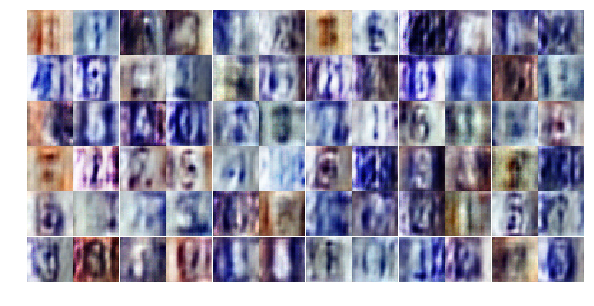

Epoch 3/25... Discriminator Loss: 0.8175... Generator Loss: 1.3154
Epoch 3/25... Discriminator Loss: 0.5405... Generator Loss: 2.3042
Epoch 3/25... Discriminator Loss: 0.5933... Generator Loss: 1.4309
Epoch 3/25... Discriminator Loss: 0.5206... Generator Loss: 2.1208
Epoch 3/25... Discriminator Loss: 0.6480... Generator Loss: 1.1970
Epoch 3/25... Discriminator Loss: 0.3468... Generator Loss: 2.8556
Epoch 3/25... Discriminator Loss: 0.4915... Generator Loss: 2.8399
Epoch 3/25... Discriminator Loss: 0.4946... Generator Loss: 1.6291
Epoch 3/25... Discriminator Loss: 0.3671... Generator Loss: 2.0440
Epoch 3/25... Discriminator Loss: 0.7644... Generator Loss: 0.9550


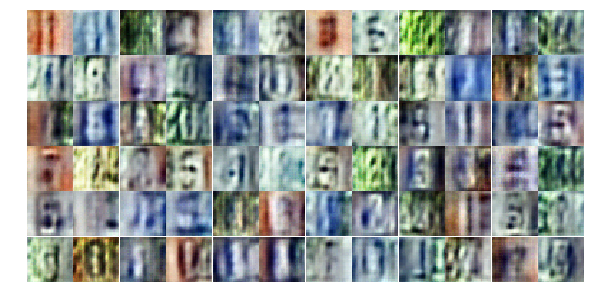

Epoch 3/25... Discriminator Loss: 0.7607... Generator Loss: 0.9692
Epoch 4/25... Discriminator Loss: 1.1401... Generator Loss: 0.5787
Epoch 4/25... Discriminator Loss: 0.6756... Generator Loss: 1.2704
Epoch 4/25... Discriminator Loss: 1.1893... Generator Loss: 0.5167
Epoch 4/25... Discriminator Loss: 0.6061... Generator Loss: 1.5513
Epoch 4/25... Discriminator Loss: 0.5516... Generator Loss: 1.2106
Epoch 4/25... Discriminator Loss: 0.4573... Generator Loss: 2.7185
Epoch 4/25... Discriminator Loss: 0.8190... Generator Loss: 0.9679
Epoch 4/25... Discriminator Loss: 0.6387... Generator Loss: 2.8296
Epoch 4/25... Discriminator Loss: 0.5608... Generator Loss: 1.7214


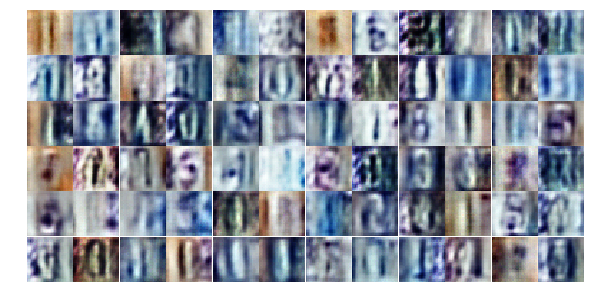

Epoch 4/25... Discriminator Loss: 0.9707... Generator Loss: 2.9040
Epoch 4/25... Discriminator Loss: 0.7769... Generator Loss: 0.8405
Epoch 4/25... Discriminator Loss: 0.7338... Generator Loss: 2.3471
Epoch 4/25... Discriminator Loss: 1.1382... Generator Loss: 0.8895
Epoch 4/25... Discriminator Loss: 1.1501... Generator Loss: 2.4285
Epoch 4/25... Discriminator Loss: 0.9925... Generator Loss: 0.9407
Epoch 4/25... Discriminator Loss: 1.7988... Generator Loss: 0.2579
Epoch 4/25... Discriminator Loss: 0.5432... Generator Loss: 1.4972
Epoch 4/25... Discriminator Loss: 1.1191... Generator Loss: 2.0035
Epoch 4/25... Discriminator Loss: 1.0420... Generator Loss: 3.8727


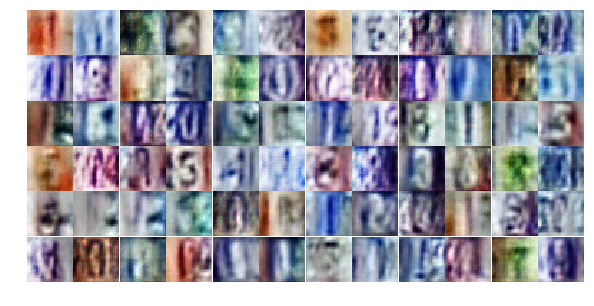

Epoch 4/25... Discriminator Loss: 0.5429... Generator Loss: 1.4478
Epoch 4/25... Discriminator Loss: 0.5150... Generator Loss: 1.3660
Epoch 4/25... Discriminator Loss: 0.9471... Generator Loss: 0.6617
Epoch 4/25... Discriminator Loss: 1.2002... Generator Loss: 0.5182
Epoch 4/25... Discriminator Loss: 0.9346... Generator Loss: 0.6636
Epoch 4/25... Discriminator Loss: 0.3727... Generator Loss: 1.7781
Epoch 4/25... Discriminator Loss: 0.4428... Generator Loss: 1.5024
Epoch 4/25... Discriminator Loss: 0.4667... Generator Loss: 2.7505
Epoch 4/25... Discriminator Loss: 0.8515... Generator Loss: 3.1063
Epoch 4/25... Discriminator Loss: 1.1567... Generator Loss: 0.5642


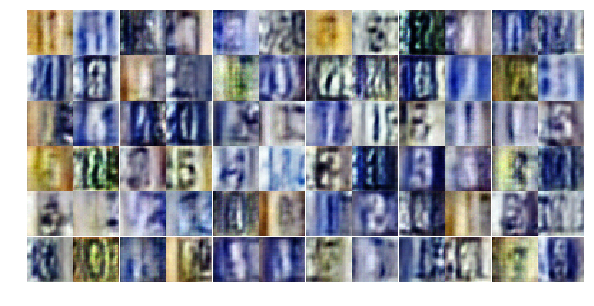

Epoch 4/25... Discriminator Loss: 0.4407... Generator Loss: 1.9085
Epoch 4/25... Discriminator Loss: 0.6478... Generator Loss: 1.8033
Epoch 4/25... Discriminator Loss: 0.6245... Generator Loss: 1.2285
Epoch 4/25... Discriminator Loss: 0.4839... Generator Loss: 1.6683
Epoch 4/25... Discriminator Loss: 0.4024... Generator Loss: 2.0609
Epoch 4/25... Discriminator Loss: 0.3982... Generator Loss: 1.7307
Epoch 4/25... Discriminator Loss: 0.5530... Generator Loss: 2.6640
Epoch 4/25... Discriminator Loss: 0.6127... Generator Loss: 1.2292
Epoch 4/25... Discriminator Loss: 0.6296... Generator Loss: 1.0823
Epoch 4/25... Discriminator Loss: 0.5630... Generator Loss: 1.2820


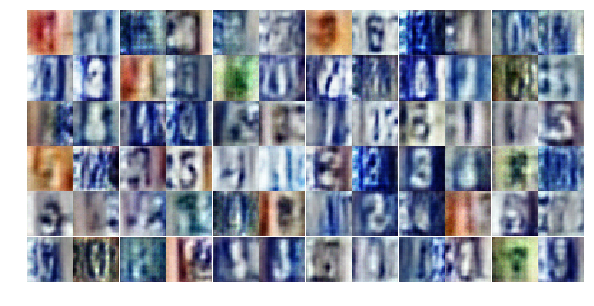

Epoch 4/25... Discriminator Loss: 0.5534... Generator Loss: 3.4110
Epoch 4/25... Discriminator Loss: 0.3483... Generator Loss: 1.7753
Epoch 4/25... Discriminator Loss: 1.1135... Generator Loss: 2.9205
Epoch 4/25... Discriminator Loss: 0.3531... Generator Loss: 2.1141
Epoch 4/25... Discriminator Loss: 0.4715... Generator Loss: 1.5343
Epoch 4/25... Discriminator Loss: 0.4435... Generator Loss: 2.3356
Epoch 4/25... Discriminator Loss: 0.7119... Generator Loss: 0.8816
Epoch 4/25... Discriminator Loss: 0.6792... Generator Loss: 2.0572
Epoch 4/25... Discriminator Loss: 0.5605... Generator Loss: 1.7464
Epoch 4/25... Discriminator Loss: 0.6356... Generator Loss: 2.5075


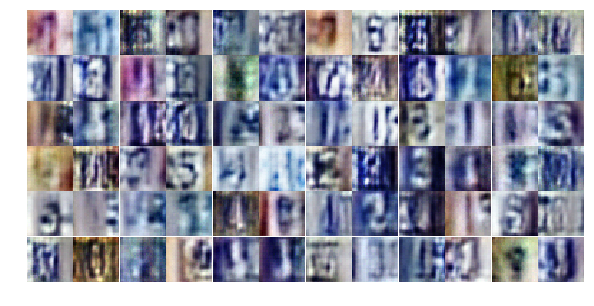

Epoch 4/25... Discriminator Loss: 0.5348... Generator Loss: 1.8620
Epoch 4/25... Discriminator Loss: 0.6614... Generator Loss: 1.6582
Epoch 4/25... Discriminator Loss: 0.4013... Generator Loss: 1.9954
Epoch 4/25... Discriminator Loss: 0.7347... Generator Loss: 1.6201
Epoch 4/25... Discriminator Loss: 0.7887... Generator Loss: 0.9226
Epoch 4/25... Discriminator Loss: 0.6080... Generator Loss: 1.3045
Epoch 4/25... Discriminator Loss: 0.5112... Generator Loss: 1.3719
Epoch 4/25... Discriminator Loss: 1.0763... Generator Loss: 0.5435
Epoch 4/25... Discriminator Loss: 0.4732... Generator Loss: 1.7555
Epoch 5/25... Discriminator Loss: 0.8078... Generator Loss: 2.4357


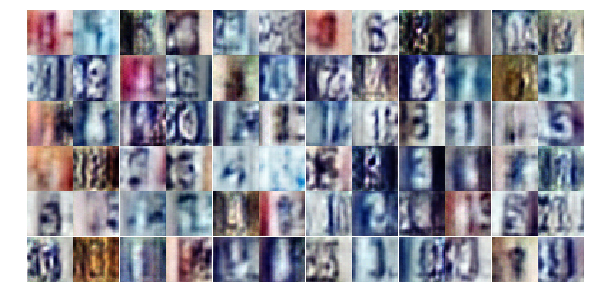

Epoch 5/25... Discriminator Loss: 0.2934... Generator Loss: 2.3049
Epoch 5/25... Discriminator Loss: 1.3677... Generator Loss: 0.5731
Epoch 5/25... Discriminator Loss: 0.5370... Generator Loss: 1.9629
Epoch 5/25... Discriminator Loss: 0.9695... Generator Loss: 0.6253
Epoch 5/25... Discriminator Loss: 0.3426... Generator Loss: 2.0829
Epoch 5/25... Discriminator Loss: 0.8464... Generator Loss: 0.7596
Epoch 5/25... Discriminator Loss: 0.6366... Generator Loss: 1.0215
Epoch 5/25... Discriminator Loss: 0.5281... Generator Loss: 1.4442
Epoch 5/25... Discriminator Loss: 0.4837... Generator Loss: 2.1014
Epoch 5/25... Discriminator Loss: 0.7186... Generator Loss: 2.0112


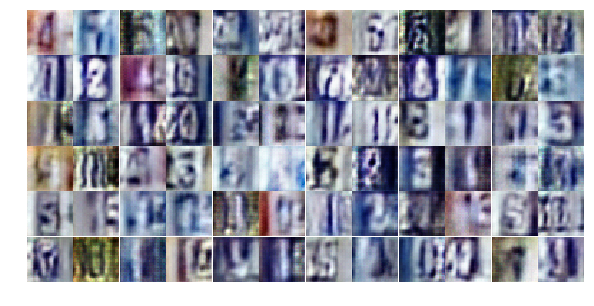

Epoch 5/25... Discriminator Loss: 0.6914... Generator Loss: 2.5971
Epoch 5/25... Discriminator Loss: 0.5950... Generator Loss: 1.4133
Epoch 5/25... Discriminator Loss: 0.3149... Generator Loss: 1.9174
Epoch 5/25... Discriminator Loss: 0.5233... Generator Loss: 1.4676
Epoch 5/25... Discriminator Loss: 0.9896... Generator Loss: 0.6860
Epoch 5/25... Discriminator Loss: 0.8078... Generator Loss: 1.6762
Epoch 5/25... Discriminator Loss: 0.8757... Generator Loss: 0.9786
Epoch 5/25... Discriminator Loss: 0.6467... Generator Loss: 2.0624
Epoch 5/25... Discriminator Loss: 0.4710... Generator Loss: 1.4361
Epoch 5/25... Discriminator Loss: 0.5107... Generator Loss: 1.3780


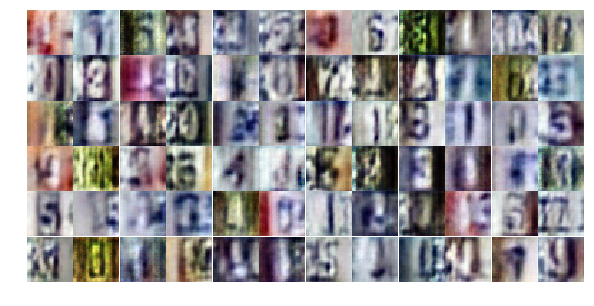

Epoch 5/25... Discriminator Loss: 0.5452... Generator Loss: 1.2063
Epoch 5/25... Discriminator Loss: 0.7367... Generator Loss: 1.0035
Epoch 5/25... Discriminator Loss: 0.8880... Generator Loss: 0.7226
Epoch 5/25... Discriminator Loss: 0.5650... Generator Loss: 1.2332
Epoch 5/25... Discriminator Loss: 0.6894... Generator Loss: 1.0414
Epoch 5/25... Discriminator Loss: 0.5940... Generator Loss: 1.1654
Epoch 5/25... Discriminator Loss: 0.8755... Generator Loss: 0.7331
Epoch 5/25... Discriminator Loss: 1.1656... Generator Loss: 0.5272
Epoch 5/25... Discriminator Loss: 0.7247... Generator Loss: 0.9855
Epoch 5/25... Discriminator Loss: 0.4967... Generator Loss: 1.4168


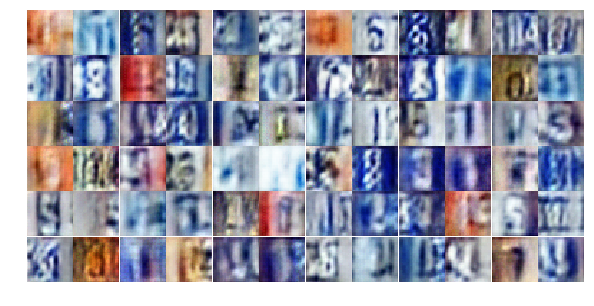

Epoch 5/25... Discriminator Loss: 0.5589... Generator Loss: 1.4762
Epoch 5/25... Discriminator Loss: 0.5521... Generator Loss: 1.2236
Epoch 5/25... Discriminator Loss: 0.5420... Generator Loss: 2.4996
Epoch 5/25... Discriminator Loss: 0.4713... Generator Loss: 2.1721
Epoch 5/25... Discriminator Loss: 0.4088... Generator Loss: 1.4347
Epoch 5/25... Discriminator Loss: 0.7642... Generator Loss: 3.1517
Epoch 5/25... Discriminator Loss: 1.4365... Generator Loss: 0.4224
Epoch 5/25... Discriminator Loss: 0.6633... Generator Loss: 1.0609
Epoch 5/25... Discriminator Loss: 0.8694... Generator Loss: 0.8206
Epoch 5/25... Discriminator Loss: 0.4887... Generator Loss: 1.3377


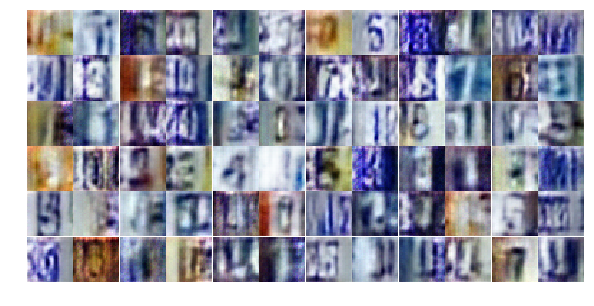

Epoch 5/25... Discriminator Loss: 0.3636... Generator Loss: 2.6813
Epoch 5/25... Discriminator Loss: 0.5488... Generator Loss: 1.1430
Epoch 5/25... Discriminator Loss: 1.0627... Generator Loss: 0.6015
Epoch 5/25... Discriminator Loss: 0.5419... Generator Loss: 1.2058
Epoch 5/25... Discriminator Loss: 1.3861... Generator Loss: 0.3797
Epoch 5/25... Discriminator Loss: 1.3820... Generator Loss: 0.5132
Epoch 5/25... Discriminator Loss: 0.8675... Generator Loss: 0.8696
Epoch 5/25... Discriminator Loss: 0.6444... Generator Loss: 1.1454
Epoch 5/25... Discriminator Loss: 0.5669... Generator Loss: 1.3946
Epoch 5/25... Discriminator Loss: 0.4494... Generator Loss: 1.4590


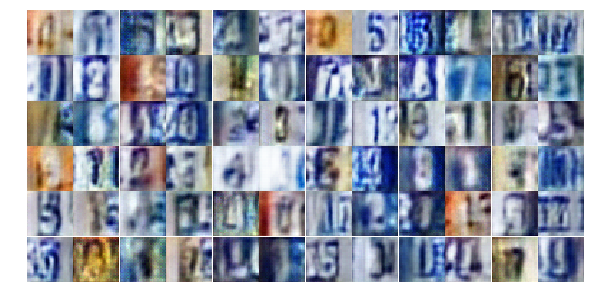

Epoch 5/25... Discriminator Loss: 1.6941... Generator Loss: 0.2645
Epoch 5/25... Discriminator Loss: 0.6670... Generator Loss: 0.9925
Epoch 5/25... Discriminator Loss: 1.1249... Generator Loss: 0.5851
Epoch 5/25... Discriminator Loss: 0.8534... Generator Loss: 0.7927
Epoch 5/25... Discriminator Loss: 0.7770... Generator Loss: 2.6431
Epoch 5/25... Discriminator Loss: 1.1390... Generator Loss: 0.6804
Epoch 6/25... Discriminator Loss: 0.7838... Generator Loss: 0.9610
Epoch 6/25... Discriminator Loss: 0.3609... Generator Loss: 2.1852
Epoch 6/25... Discriminator Loss: 0.4605... Generator Loss: 1.8551
Epoch 6/25... Discriminator Loss: 1.1222... Generator Loss: 0.5049


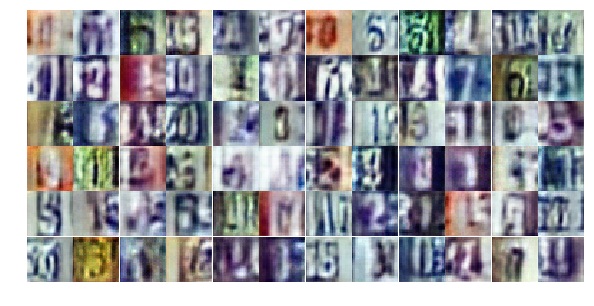

Epoch 6/25... Discriminator Loss: 0.6112... Generator Loss: 1.1393
Epoch 6/25... Discriminator Loss: 0.8792... Generator Loss: 0.8263
Epoch 6/25... Discriminator Loss: 0.7575... Generator Loss: 2.6600
Epoch 6/25... Discriminator Loss: 0.6106... Generator Loss: 1.5626
Epoch 6/25... Discriminator Loss: 0.7974... Generator Loss: 0.8091
Epoch 6/25... Discriminator Loss: 0.4629... Generator Loss: 1.3061
Epoch 6/25... Discriminator Loss: 0.5181... Generator Loss: 1.3051
Epoch 6/25... Discriminator Loss: 0.8596... Generator Loss: 0.8292
Epoch 6/25... Discriminator Loss: 0.9237... Generator Loss: 0.7015
Epoch 6/25... Discriminator Loss: 0.6299... Generator Loss: 1.0668


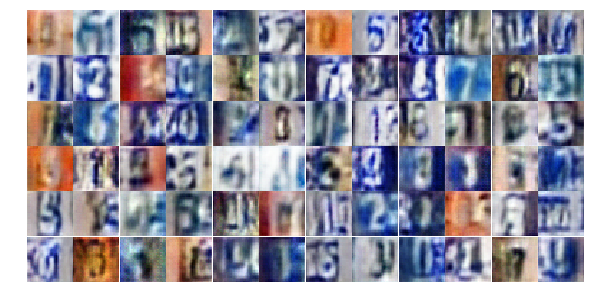

Epoch 6/25... Discriminator Loss: 0.4518... Generator Loss: 1.9574
Epoch 6/25... Discriminator Loss: 1.3349... Generator Loss: 1.7778
Epoch 6/25... Discriminator Loss: 1.1120... Generator Loss: 0.7577
Epoch 6/25... Discriminator Loss: 1.2538... Generator Loss: 0.4479
Epoch 6/25... Discriminator Loss: 0.6427... Generator Loss: 1.4426
Epoch 6/25... Discriminator Loss: 0.6658... Generator Loss: 1.2720
Epoch 6/25... Discriminator Loss: 0.5513... Generator Loss: 1.6079
Epoch 6/25... Discriminator Loss: 0.6412... Generator Loss: 1.1768
Epoch 6/25... Discriminator Loss: 0.5396... Generator Loss: 2.5589
Epoch 6/25... Discriminator Loss: 0.9569... Generator Loss: 0.7200


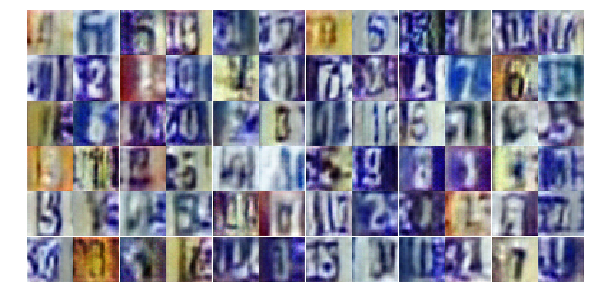

Epoch 6/25... Discriminator Loss: 0.8904... Generator Loss: 0.7496
Epoch 6/25... Discriminator Loss: 0.6183... Generator Loss: 1.2330
Epoch 6/25... Discriminator Loss: 0.8153... Generator Loss: 1.3311
Epoch 6/25... Discriminator Loss: 0.6533... Generator Loss: 1.2740
Epoch 6/25... Discriminator Loss: 0.4594... Generator Loss: 1.5184
Epoch 6/25... Discriminator Loss: 1.3733... Generator Loss: 0.4297
Epoch 6/25... Discriminator Loss: 0.6070... Generator Loss: 1.5378
Epoch 6/25... Discriminator Loss: 0.2523... Generator Loss: 2.0689
Epoch 6/25... Discriminator Loss: 0.5020... Generator Loss: 1.3824
Epoch 6/25... Discriminator Loss: 0.4302... Generator Loss: 2.1658


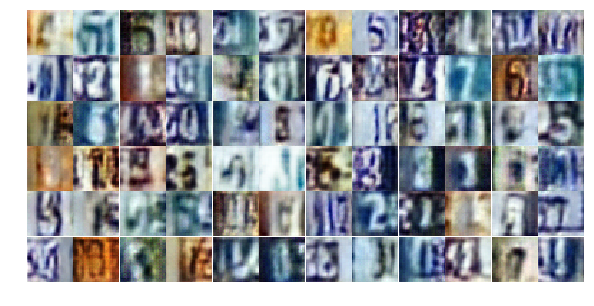

Epoch 6/25... Discriminator Loss: 1.2816... Generator Loss: 0.5420
Epoch 6/25... Discriminator Loss: 0.9426... Generator Loss: 0.9994
Epoch 6/25... Discriminator Loss: 0.6965... Generator Loss: 0.9985
Epoch 6/25... Discriminator Loss: 0.6353... Generator Loss: 1.0653
Epoch 6/25... Discriminator Loss: 0.6993... Generator Loss: 1.0189
Epoch 6/25... Discriminator Loss: 0.4930... Generator Loss: 1.3226
Epoch 6/25... Discriminator Loss: 0.4080... Generator Loss: 1.7017
Epoch 6/25... Discriminator Loss: 0.5602... Generator Loss: 2.3335
Epoch 6/25... Discriminator Loss: 0.9175... Generator Loss: 0.7437
Epoch 6/25... Discriminator Loss: 0.3596... Generator Loss: 1.5794


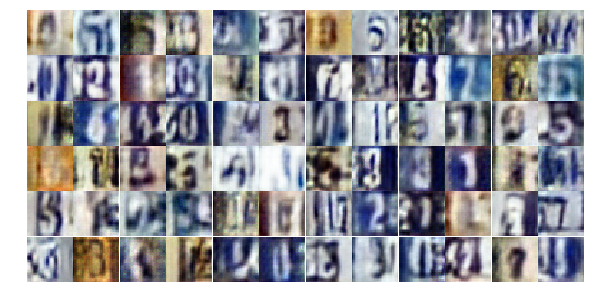

Epoch 6/25... Discriminator Loss: 0.5512... Generator Loss: 1.9151
Epoch 6/25... Discriminator Loss: 0.3825... Generator Loss: 2.1598
Epoch 6/25... Discriminator Loss: 2.5023... Generator Loss: 0.1444
Epoch 6/25... Discriminator Loss: 0.6764... Generator Loss: 2.0758
Epoch 6/25... Discriminator Loss: 0.6472... Generator Loss: 1.2944
Epoch 6/25... Discriminator Loss: 0.5473... Generator Loss: 1.2778
Epoch 6/25... Discriminator Loss: 0.5933... Generator Loss: 1.1944
Epoch 6/25... Discriminator Loss: 1.3428... Generator Loss: 0.4370
Epoch 6/25... Discriminator Loss: 0.6441... Generator Loss: 1.7680
Epoch 6/25... Discriminator Loss: 1.7965... Generator Loss: 0.2623


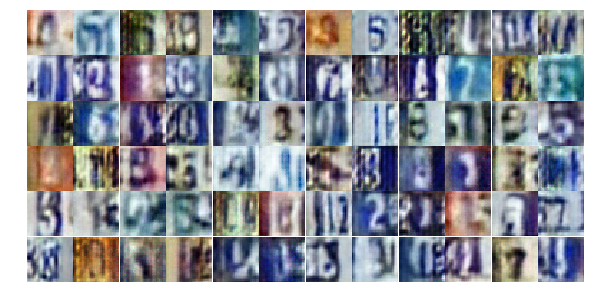

Epoch 6/25... Discriminator Loss: 0.5167... Generator Loss: 1.3783
Epoch 6/25... Discriminator Loss: 0.4507... Generator Loss: 1.6854
Epoch 6/25... Discriminator Loss: 0.4557... Generator Loss: 2.3208
Epoch 7/25... Discriminator Loss: 0.6731... Generator Loss: 1.3318
Epoch 7/25... Discriminator Loss: 0.5558... Generator Loss: 1.4507
Epoch 7/25... Discriminator Loss: 0.5723... Generator Loss: 1.4216
Epoch 7/25... Discriminator Loss: 0.3826... Generator Loss: 1.7853
Epoch 7/25... Discriminator Loss: 0.3932... Generator Loss: 2.0940
Epoch 7/25... Discriminator Loss: 0.3930... Generator Loss: 2.0575
Epoch 7/25... Discriminator Loss: 0.5922... Generator Loss: 2.8794


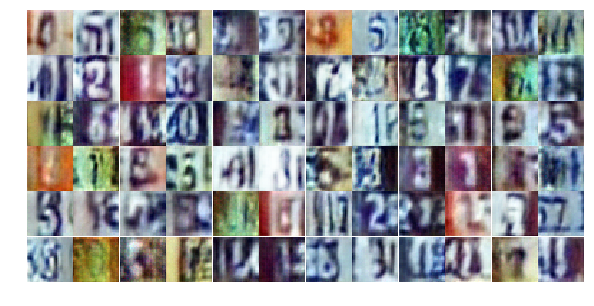

Epoch 7/25... Discriminator Loss: 0.4845... Generator Loss: 1.8247
Epoch 7/25... Discriminator Loss: 0.5174... Generator Loss: 1.4062
Epoch 7/25... Discriminator Loss: 1.1597... Generator Loss: 0.4695
Epoch 7/25... Discriminator Loss: 0.7887... Generator Loss: 2.4065
Epoch 7/25... Discriminator Loss: 0.6628... Generator Loss: 0.9871
Epoch 7/25... Discriminator Loss: 0.3949... Generator Loss: 1.9283
Epoch 7/25... Discriminator Loss: 0.8560... Generator Loss: 3.3924
Epoch 7/25... Discriminator Loss: 1.4396... Generator Loss: 3.5895
Epoch 7/25... Discriminator Loss: 1.1543... Generator Loss: 4.6758
Epoch 7/25... Discriminator Loss: 0.4250... Generator Loss: 2.6536


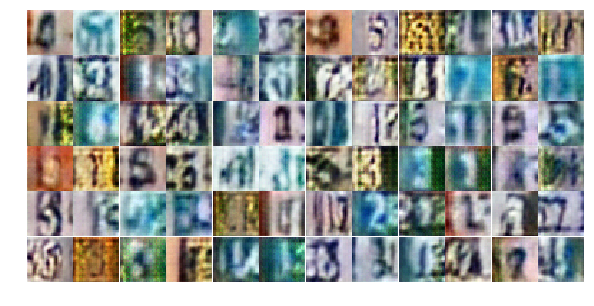

Epoch 7/25... Discriminator Loss: 0.8311... Generator Loss: 0.8600
Epoch 7/25... Discriminator Loss: 0.5437... Generator Loss: 1.5776
Epoch 7/25... Discriminator Loss: 0.9637... Generator Loss: 0.7061
Epoch 7/25... Discriminator Loss: 0.6527... Generator Loss: 1.0836
Epoch 7/25... Discriminator Loss: 0.4423... Generator Loss: 1.4336
Epoch 7/25... Discriminator Loss: 0.5972... Generator Loss: 1.3349
Epoch 7/25... Discriminator Loss: 0.6835... Generator Loss: 1.4182
Epoch 7/25... Discriminator Loss: 0.3403... Generator Loss: 1.6666
Epoch 7/25... Discriminator Loss: 0.3791... Generator Loss: 1.8952
Epoch 7/25... Discriminator Loss: 0.5453... Generator Loss: 1.3309


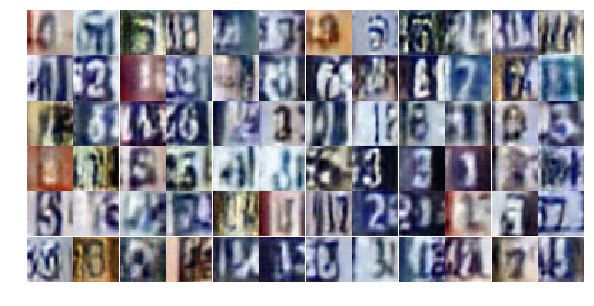

Epoch 7/25... Discriminator Loss: 0.7364... Generator Loss: 0.8607
Epoch 7/25... Discriminator Loss: 0.7438... Generator Loss: 0.8918
Epoch 7/25... Discriminator Loss: 0.6468... Generator Loss: 1.2017
Epoch 7/25... Discriminator Loss: 0.6749... Generator Loss: 1.0454
Epoch 7/25... Discriminator Loss: 0.6212... Generator Loss: 1.1331
Epoch 7/25... Discriminator Loss: 0.8370... Generator Loss: 0.7902
Epoch 7/25... Discriminator Loss: 0.7456... Generator Loss: 0.8461
Epoch 7/25... Discriminator Loss: 1.1726... Generator Loss: 0.4886
Epoch 7/25... Discriminator Loss: 0.8968... Generator Loss: 0.8549
Epoch 7/25... Discriminator Loss: 0.4552... Generator Loss: 2.0188


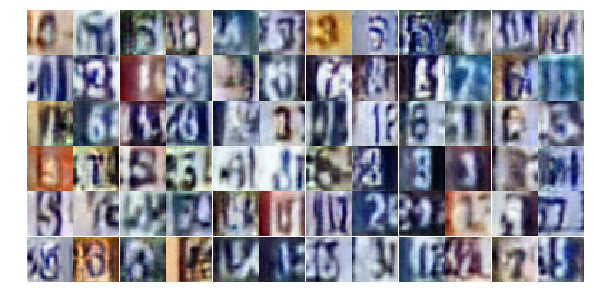

Epoch 7/25... Discriminator Loss: 1.0477... Generator Loss: 0.7006
Epoch 7/25... Discriminator Loss: 0.8269... Generator Loss: 0.9635
Epoch 7/25... Discriminator Loss: 0.3282... Generator Loss: 1.6889
Epoch 7/25... Discriminator Loss: 0.5815... Generator Loss: 2.0564
Epoch 7/25... Discriminator Loss: 0.7442... Generator Loss: 1.2566
Epoch 7/25... Discriminator Loss: 0.4337... Generator Loss: 1.8362
Epoch 7/25... Discriminator Loss: 0.5317... Generator Loss: 1.2897
Epoch 7/25... Discriminator Loss: 0.6856... Generator Loss: 1.0434
Epoch 7/25... Discriminator Loss: 0.4003... Generator Loss: 1.7071
Epoch 7/25... Discriminator Loss: 1.2259... Generator Loss: 0.5093


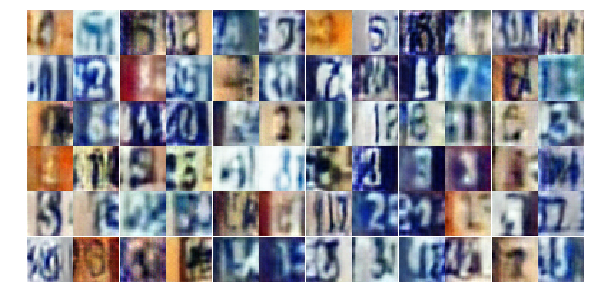

Epoch 7/25... Discriminator Loss: 0.5983... Generator Loss: 1.1314
Epoch 7/25... Discriminator Loss: 0.7899... Generator Loss: 0.9613
Epoch 7/25... Discriminator Loss: 0.7615... Generator Loss: 0.9022
Epoch 7/25... Discriminator Loss: 0.8381... Generator Loss: 0.7853
Epoch 7/25... Discriminator Loss: 0.5351... Generator Loss: 1.2734
Epoch 7/25... Discriminator Loss: 0.8642... Generator Loss: 0.7792
Epoch 7/25... Discriminator Loss: 1.1602... Generator Loss: 0.4841
Epoch 7/25... Discriminator Loss: 1.3164... Generator Loss: 0.4327
Epoch 7/25... Discriminator Loss: 0.9452... Generator Loss: 0.7217
Epoch 7/25... Discriminator Loss: 0.4913... Generator Loss: 1.5404


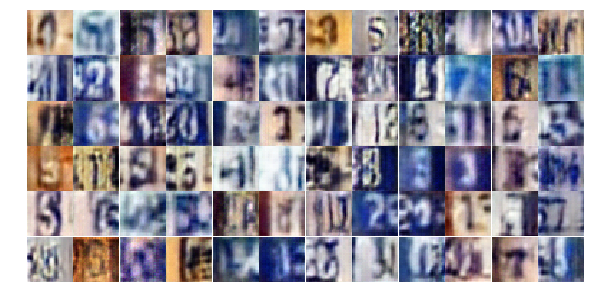

Epoch 7/25... Discriminator Loss: 0.4351... Generator Loss: 2.1616
Epoch 8/25... Discriminator Loss: 0.8596... Generator Loss: 0.7586
Epoch 8/25... Discriminator Loss: 0.5430... Generator Loss: 1.1945
Epoch 8/25... Discriminator Loss: 0.5269... Generator Loss: 1.2490
Epoch 8/25... Discriminator Loss: 0.4777... Generator Loss: 1.8308
Epoch 8/25... Discriminator Loss: 0.9181... Generator Loss: 1.8827
Epoch 8/25... Discriminator Loss: 0.5566... Generator Loss: 1.2822
Epoch 8/25... Discriminator Loss: 0.3734... Generator Loss: 1.6877
Epoch 8/25... Discriminator Loss: 0.8279... Generator Loss: 0.7663
Epoch 8/25... Discriminator Loss: 0.6742... Generator Loss: 0.9865


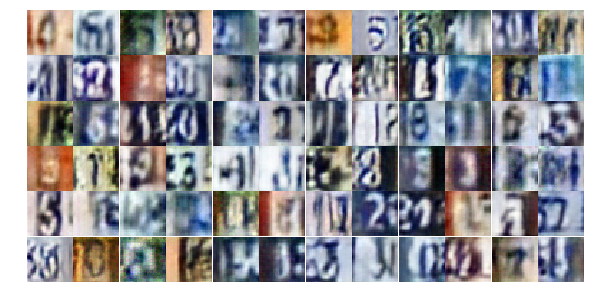

Epoch 8/25... Discriminator Loss: 0.6138... Generator Loss: 1.0853
Epoch 8/25... Discriminator Loss: 0.4921... Generator Loss: 1.4215
Epoch 8/25... Discriminator Loss: 0.6512... Generator Loss: 1.4257
Epoch 8/25... Discriminator Loss: 0.5372... Generator Loss: 2.8678
Epoch 8/25... Discriminator Loss: 0.6346... Generator Loss: 1.1460
Epoch 8/25... Discriminator Loss: 0.6405... Generator Loss: 2.0098
Epoch 8/25... Discriminator Loss: 0.5440... Generator Loss: 1.7992
Epoch 8/25... Discriminator Loss: 0.6623... Generator Loss: 1.0694
Epoch 8/25... Discriminator Loss: 0.4826... Generator Loss: 1.6775
Epoch 8/25... Discriminator Loss: 0.8012... Generator Loss: 1.2417


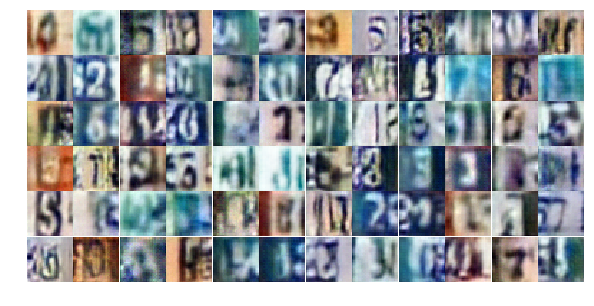

Epoch 8/25... Discriminator Loss: 0.4452... Generator Loss: 1.6113
Epoch 8/25... Discriminator Loss: 0.2985... Generator Loss: 1.8543
Epoch 8/25... Discriminator Loss: 0.8183... Generator Loss: 2.3285
Epoch 8/25... Discriminator Loss: 0.8329... Generator Loss: 2.3530
Epoch 8/25... Discriminator Loss: 0.6098... Generator Loss: 1.1499
Epoch 8/25... Discriminator Loss: 0.6768... Generator Loss: 1.2536
Epoch 8/25... Discriminator Loss: 0.6461... Generator Loss: 1.2758
Epoch 8/25... Discriminator Loss: 0.5675... Generator Loss: 1.1077
Epoch 8/25... Discriminator Loss: 0.7306... Generator Loss: 1.8727
Epoch 8/25... Discriminator Loss: 0.5601... Generator Loss: 1.2814


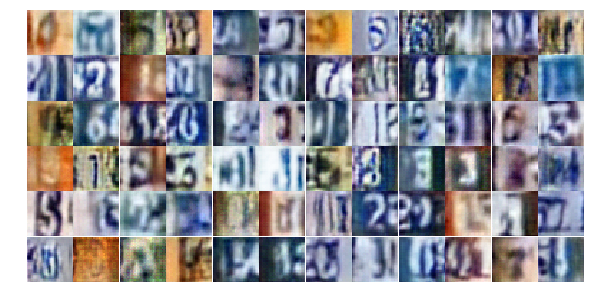

Epoch 8/25... Discriminator Loss: 0.8335... Generator Loss: 0.7337
Epoch 8/25... Discriminator Loss: 1.0761... Generator Loss: 0.5846
Epoch 8/25... Discriminator Loss: 0.6089... Generator Loss: 1.2085
Epoch 8/25... Discriminator Loss: 0.8348... Generator Loss: 0.8093
Epoch 8/25... Discriminator Loss: 0.6003... Generator Loss: 1.1210
Epoch 8/25... Discriminator Loss: 0.4078... Generator Loss: 1.7302
Epoch 8/25... Discriminator Loss: 0.6343... Generator Loss: 1.5581
Epoch 8/25... Discriminator Loss: 0.5400... Generator Loss: 1.4843
Epoch 8/25... Discriminator Loss: 1.2627... Generator Loss: 0.4474
Epoch 8/25... Discriminator Loss: 0.5246... Generator Loss: 1.5083


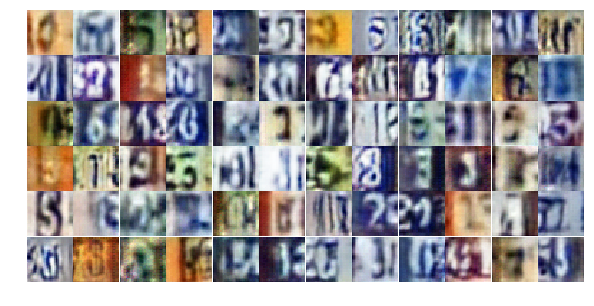

Epoch 8/25... Discriminator Loss: 0.4348... Generator Loss: 2.4429
Epoch 8/25... Discriminator Loss: 0.9132... Generator Loss: 1.1729
Epoch 8/25... Discriminator Loss: 0.5635... Generator Loss: 1.0935
Epoch 8/25... Discriminator Loss: 0.5067... Generator Loss: 1.3925
Epoch 8/25... Discriminator Loss: 0.6257... Generator Loss: 1.9285
Epoch 8/25... Discriminator Loss: 0.5955... Generator Loss: 1.2198
Epoch 8/25... Discriminator Loss: 0.4525... Generator Loss: 1.2866
Epoch 8/25... Discriminator Loss: 0.7597... Generator Loss: 3.5794
Epoch 8/25... Discriminator Loss: 0.9151... Generator Loss: 0.7830
Epoch 8/25... Discriminator Loss: 0.4590... Generator Loss: 2.1767


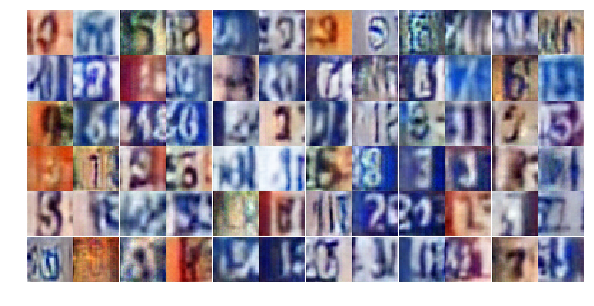

Epoch 8/25... Discriminator Loss: 0.6586... Generator Loss: 1.1335
Epoch 8/25... Discriminator Loss: 0.4679... Generator Loss: 1.7562
Epoch 8/25... Discriminator Loss: 0.4166... Generator Loss: 1.5725
Epoch 8/25... Discriminator Loss: 0.8338... Generator Loss: 2.3584
Epoch 8/25... Discriminator Loss: 0.4639... Generator Loss: 1.7503
Epoch 8/25... Discriminator Loss: 0.8645... Generator Loss: 0.8776
Epoch 8/25... Discriminator Loss: 0.4797... Generator Loss: 1.3759
Epoch 8/25... Discriminator Loss: 0.5269... Generator Loss: 1.8408
Epoch 9/25... Discriminator Loss: 0.8324... Generator Loss: 0.9896
Epoch 9/25... Discriminator Loss: 0.6357... Generator Loss: 1.0284


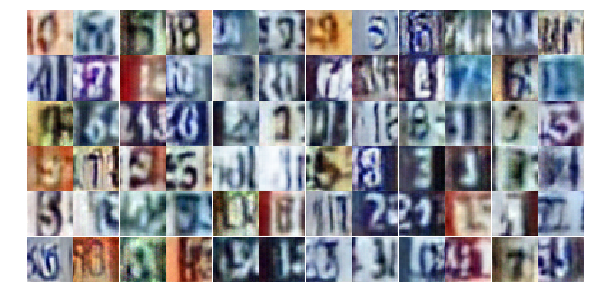

Epoch 9/25... Discriminator Loss: 0.7322... Generator Loss: 0.8703
Epoch 9/25... Discriminator Loss: 0.5425... Generator Loss: 2.1521
Epoch 9/25... Discriminator Loss: 0.8593... Generator Loss: 0.7437
Epoch 9/25... Discriminator Loss: 0.4850... Generator Loss: 2.6318
Epoch 9/25... Discriminator Loss: 1.1395... Generator Loss: 0.5712
Epoch 9/25... Discriminator Loss: 0.4699... Generator Loss: 2.0857
Epoch 9/25... Discriminator Loss: 0.8585... Generator Loss: 0.8061
Epoch 9/25... Discriminator Loss: 0.6470... Generator Loss: 1.0221
Epoch 9/25... Discriminator Loss: 0.7928... Generator Loss: 0.8022
Epoch 9/25... Discriminator Loss: 0.4614... Generator Loss: 1.9430


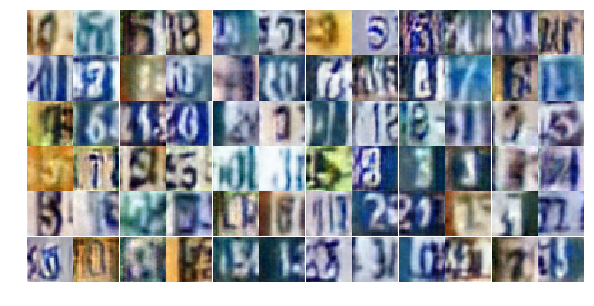

Epoch 9/25... Discriminator Loss: 0.7240... Generator Loss: 0.9119
Epoch 9/25... Discriminator Loss: 0.9423... Generator Loss: 0.7094
Epoch 9/25... Discriminator Loss: 0.6848... Generator Loss: 1.0617
Epoch 9/25... Discriminator Loss: 1.9484... Generator Loss: 0.2181
Epoch 9/25... Discriminator Loss: 0.5922... Generator Loss: 1.2755
Epoch 9/25... Discriminator Loss: 0.8382... Generator Loss: 1.0247
Epoch 9/25... Discriminator Loss: 0.4736... Generator Loss: 1.4058
Epoch 9/25... Discriminator Loss: 0.5908... Generator Loss: 1.0813
Epoch 9/25... Discriminator Loss: 1.1251... Generator Loss: 0.5409
Epoch 9/25... Discriminator Loss: 0.8994... Generator Loss: 0.7349


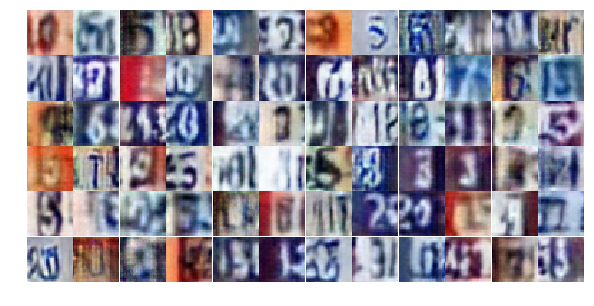

Epoch 9/25... Discriminator Loss: 0.9551... Generator Loss: 0.7105
Epoch 9/25... Discriminator Loss: 0.5519... Generator Loss: 1.4320
Epoch 9/25... Discriminator Loss: 0.4844... Generator Loss: 1.4455
Epoch 9/25... Discriminator Loss: 0.5395... Generator Loss: 1.2770
Epoch 9/25... Discriminator Loss: 0.5667... Generator Loss: 1.7419
Epoch 9/25... Discriminator Loss: 0.3279... Generator Loss: 1.9695
Epoch 9/25... Discriminator Loss: 1.0116... Generator Loss: 0.6958
Epoch 9/25... Discriminator Loss: 0.4828... Generator Loss: 1.5774
Epoch 9/25... Discriminator Loss: 0.6088... Generator Loss: 1.1538
Epoch 9/25... Discriminator Loss: 0.6472... Generator Loss: 1.0261


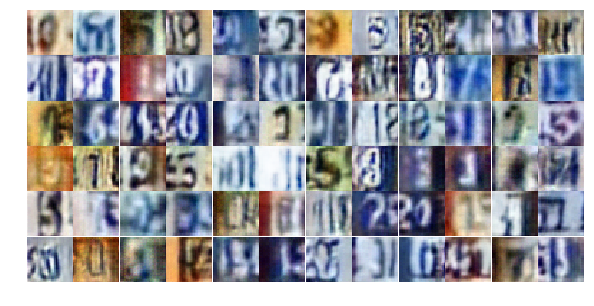

Epoch 9/25... Discriminator Loss: 0.4813... Generator Loss: 1.5397
Epoch 9/25... Discriminator Loss: 0.5052... Generator Loss: 1.3709
Epoch 9/25... Discriminator Loss: 1.0355... Generator Loss: 0.5897
Epoch 9/25... Discriminator Loss: 0.5244... Generator Loss: 1.2987
Epoch 9/25... Discriminator Loss: 1.0709... Generator Loss: 0.5787
Epoch 9/25... Discriminator Loss: 1.0360... Generator Loss: 0.6480
Epoch 9/25... Discriminator Loss: 0.6962... Generator Loss: 0.9785
Epoch 9/25... Discriminator Loss: 0.4109... Generator Loss: 1.8183
Epoch 9/25... Discriminator Loss: 1.2511... Generator Loss: 0.5298
Epoch 9/25... Discriminator Loss: 0.5763... Generator Loss: 1.2054


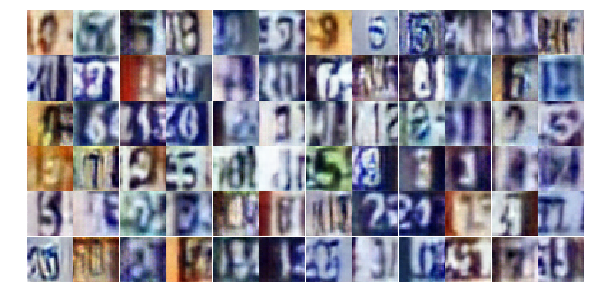

Epoch 9/25... Discriminator Loss: 0.4151... Generator Loss: 1.7049
Epoch 9/25... Discriminator Loss: 0.5688... Generator Loss: 1.1677
Epoch 9/25... Discriminator Loss: 0.5265... Generator Loss: 1.2888
Epoch 9/25... Discriminator Loss: 0.6749... Generator Loss: 1.3657
Epoch 9/25... Discriminator Loss: 0.8202... Generator Loss: 3.1691
Epoch 9/25... Discriminator Loss: 0.6927... Generator Loss: 1.0611
Epoch 9/25... Discriminator Loss: 1.0740... Generator Loss: 0.5687
Epoch 9/25... Discriminator Loss: 0.7830... Generator Loss: 0.8036
Epoch 9/25... Discriminator Loss: 0.8229... Generator Loss: 0.8019
Epoch 9/25... Discriminator Loss: 0.6681... Generator Loss: 2.4637


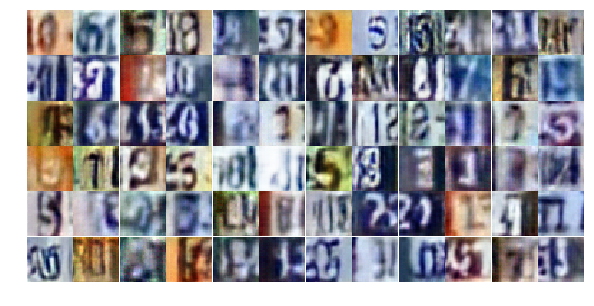

Epoch 9/25... Discriminator Loss: 1.5800... Generator Loss: 0.3424
Epoch 9/25... Discriminator Loss: 0.7299... Generator Loss: 1.3981
Epoch 9/25... Discriminator Loss: 0.5979... Generator Loss: 1.0717
Epoch 9/25... Discriminator Loss: 1.0828... Generator Loss: 0.5691
Epoch 9/25... Discriminator Loss: 0.6065... Generator Loss: 1.3283
Epoch 10/25... Discriminator Loss: 0.3838... Generator Loss: 1.6803
Epoch 10/25... Discriminator Loss: 0.3956... Generator Loss: 1.5964
Epoch 10/25... Discriminator Loss: 0.8028... Generator Loss: 0.7758
Epoch 10/25... Discriminator Loss: 0.8023... Generator Loss: 0.8409
Epoch 10/25... Discriminator Loss: 1.0475... Generator Loss: 0.5913


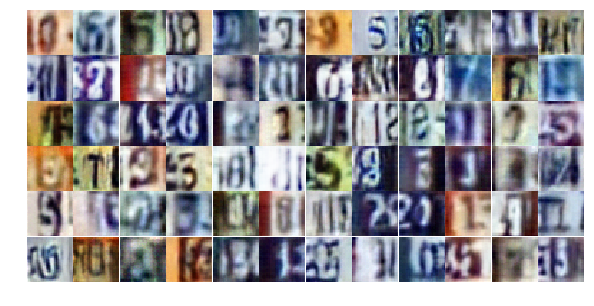

Epoch 10/25... Discriminator Loss: 0.7691... Generator Loss: 0.8556
Epoch 10/25... Discriminator Loss: 0.5204... Generator Loss: 1.3705
Epoch 10/25... Discriminator Loss: 1.5664... Generator Loss: 3.5407
Epoch 10/25... Discriminator Loss: 0.8396... Generator Loss: 0.9727
Epoch 10/25... Discriminator Loss: 0.4954... Generator Loss: 1.6214
Epoch 10/25... Discriminator Loss: 0.6363... Generator Loss: 1.1065
Epoch 10/25... Discriminator Loss: 0.8418... Generator Loss: 0.8041
Epoch 10/25... Discriminator Loss: 0.8378... Generator Loss: 0.7733
Epoch 10/25... Discriminator Loss: 0.7065... Generator Loss: 1.1140
Epoch 10/25... Discriminator Loss: 0.5965... Generator Loss: 1.5991


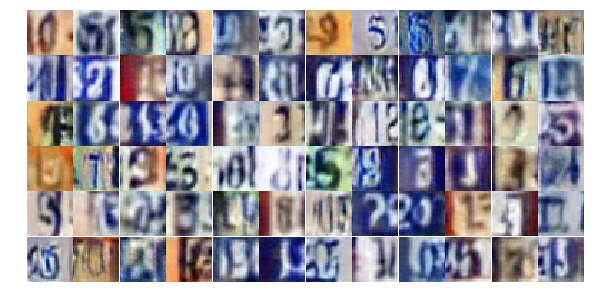

Epoch 10/25... Discriminator Loss: 0.6084... Generator Loss: 1.5500
Epoch 10/25... Discriminator Loss: 0.6278... Generator Loss: 1.0318
Epoch 10/25... Discriminator Loss: 0.6107... Generator Loss: 1.0551
Epoch 10/25... Discriminator Loss: 0.8378... Generator Loss: 0.8078
Epoch 10/25... Discriminator Loss: 0.5930... Generator Loss: 1.1475
Epoch 10/25... Discriminator Loss: 0.6360... Generator Loss: 1.0537
Epoch 10/25... Discriminator Loss: 0.5116... Generator Loss: 1.2914
Epoch 10/25... Discriminator Loss: 0.5118... Generator Loss: 1.5211
Epoch 10/25... Discriminator Loss: 1.5687... Generator Loss: 0.3456
Epoch 10/25... Discriminator Loss: 0.4908... Generator Loss: 2.2530


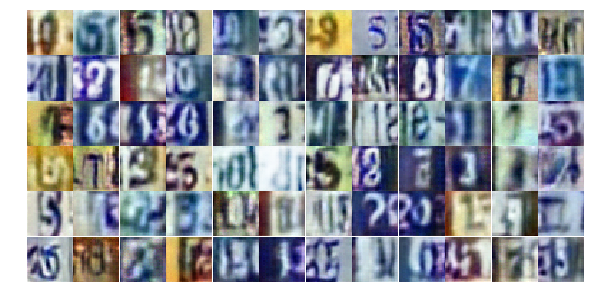

Epoch 10/25... Discriminator Loss: 0.8180... Generator Loss: 0.7847
Epoch 10/25... Discriminator Loss: 0.7364... Generator Loss: 0.9686
Epoch 10/25... Discriminator Loss: 0.3996... Generator Loss: 1.8084
Epoch 10/25... Discriminator Loss: 0.4184... Generator Loss: 2.1456
Epoch 10/25... Discriminator Loss: 1.4078... Generator Loss: 0.3770
Epoch 10/25... Discriminator Loss: 0.5708... Generator Loss: 1.3001
Epoch 10/25... Discriminator Loss: 0.3647... Generator Loss: 1.7892
Epoch 10/25... Discriminator Loss: 0.7615... Generator Loss: 0.8577
Epoch 10/25... Discriminator Loss: 0.6205... Generator Loss: 1.0093
Epoch 10/25... Discriminator Loss: 1.0232... Generator Loss: 0.6031


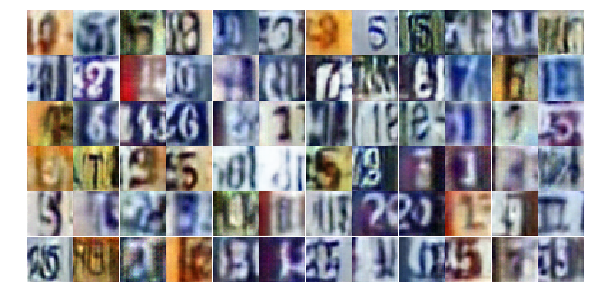

Epoch 10/25... Discriminator Loss: 0.7006... Generator Loss: 2.1230
Epoch 10/25... Discriminator Loss: 0.4920... Generator Loss: 1.6119
Epoch 10/25... Discriminator Loss: 0.6060... Generator Loss: 1.1839
Epoch 10/25... Discriminator Loss: 0.5780... Generator Loss: 1.2967
Epoch 10/25... Discriminator Loss: 0.5076... Generator Loss: 1.5710
Epoch 10/25... Discriminator Loss: 0.6845... Generator Loss: 1.4147
Epoch 10/25... Discriminator Loss: 0.5805... Generator Loss: 1.2276
Epoch 10/25... Discriminator Loss: 0.8097... Generator Loss: 0.8591
Epoch 10/25... Discriminator Loss: 0.5772... Generator Loss: 1.1827
Epoch 10/25... Discriminator Loss: 0.4438... Generator Loss: 1.8022


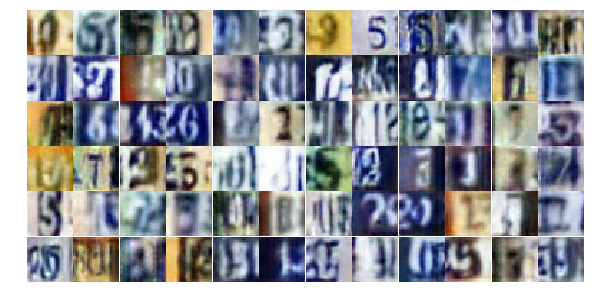

Epoch 10/25... Discriminator Loss: 0.4492... Generator Loss: 1.3314
Epoch 10/25... Discriminator Loss: 2.3808... Generator Loss: 4.3571
Epoch 10/25... Discriminator Loss: 0.7452... Generator Loss: 0.9235
Epoch 10/25... Discriminator Loss: 0.7609... Generator Loss: 1.0833
Epoch 10/25... Discriminator Loss: 0.5507... Generator Loss: 1.5111
Epoch 10/25... Discriminator Loss: 0.5543... Generator Loss: 1.2438
Epoch 10/25... Discriminator Loss: 0.4532... Generator Loss: 1.5281
Epoch 10/25... Discriminator Loss: 1.1232... Generator Loss: 3.0056
Epoch 10/25... Discriminator Loss: 0.7771... Generator Loss: 1.3015
Epoch 10/25... Discriminator Loss: 0.5176... Generator Loss: 1.4886


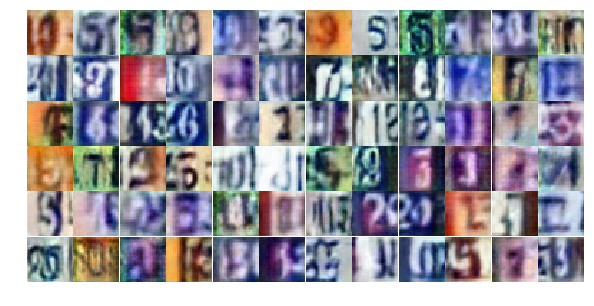

Epoch 10/25... Discriminator Loss: 0.9205... Generator Loss: 1.5931
Epoch 10/25... Discriminator Loss: 0.5041... Generator Loss: 1.3782
Epoch 10/25... Discriminator Loss: 0.6124... Generator Loss: 1.1752
Epoch 11/25... Discriminator Loss: 0.8820... Generator Loss: 0.7508
Epoch 11/25... Discriminator Loss: 0.7047... Generator Loss: 0.9313
Epoch 11/25... Discriminator Loss: 0.7878... Generator Loss: 1.2494
Epoch 11/25... Discriminator Loss: 0.5909... Generator Loss: 1.1956
Epoch 11/25... Discriminator Loss: 0.5294... Generator Loss: 1.8898
Epoch 11/25... Discriminator Loss: 1.3566... Generator Loss: 0.4588
Epoch 11/25... Discriminator Loss: 0.5772... Generator Loss: 1.3080


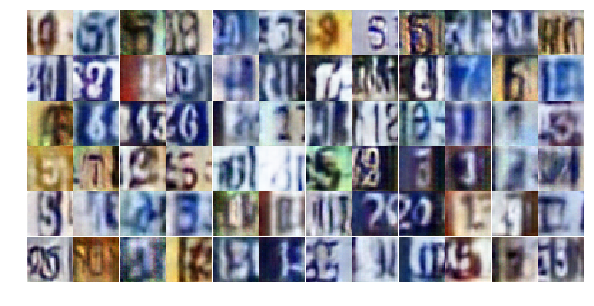

Epoch 11/25... Discriminator Loss: 0.4048... Generator Loss: 1.8814
Epoch 11/25... Discriminator Loss: 0.6857... Generator Loss: 1.0085
Epoch 11/25... Discriminator Loss: 0.5379... Generator Loss: 1.2388
Epoch 11/25... Discriminator Loss: 0.7238... Generator Loss: 0.8831
Epoch 11/25... Discriminator Loss: 0.8100... Generator Loss: 0.8098
Epoch 11/25... Discriminator Loss: 0.3843... Generator Loss: 1.8161
Epoch 11/25... Discriminator Loss: 0.6349... Generator Loss: 1.4812
Epoch 11/25... Discriminator Loss: 0.4946... Generator Loss: 1.4215
Epoch 11/25... Discriminator Loss: 0.5692... Generator Loss: 1.1483
Epoch 11/25... Discriminator Loss: 1.3857... Generator Loss: 0.4137


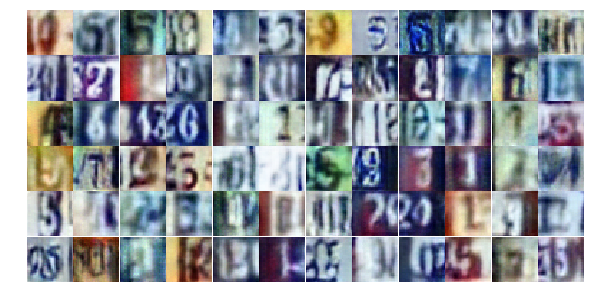

Epoch 11/25... Discriminator Loss: 0.7451... Generator Loss: 0.9986
Epoch 11/25... Discriminator Loss: 0.6096... Generator Loss: 2.0863
Epoch 11/25... Discriminator Loss: 0.7160... Generator Loss: 0.9655
Epoch 11/25... Discriminator Loss: 0.6795... Generator Loss: 0.9609
Epoch 11/25... Discriminator Loss: 0.4713... Generator Loss: 1.2316
Epoch 11/25... Discriminator Loss: 0.4052... Generator Loss: 2.2141
Epoch 11/25... Discriminator Loss: 0.5719... Generator Loss: 1.5891
Epoch 11/25... Discriminator Loss: 0.9135... Generator Loss: 0.7579
Epoch 11/25... Discriminator Loss: 0.3856... Generator Loss: 1.8122
Epoch 11/25... Discriminator Loss: 0.6426... Generator Loss: 1.0376


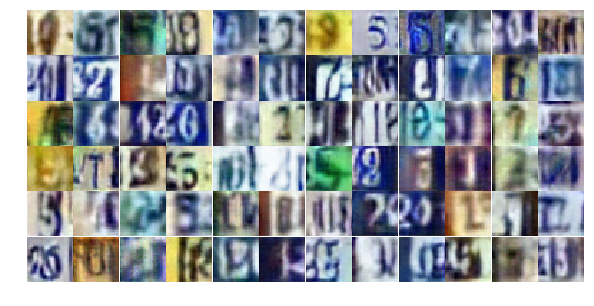

Epoch 11/25... Discriminator Loss: 0.6484... Generator Loss: 1.0491
Epoch 11/25... Discriminator Loss: 0.6067... Generator Loss: 1.1508
Epoch 11/25... Discriminator Loss: 0.8284... Generator Loss: 0.8267
Epoch 11/25... Discriminator Loss: 0.6526... Generator Loss: 1.0046
Epoch 11/25... Discriminator Loss: 0.6797... Generator Loss: 1.0035
Epoch 11/25... Discriminator Loss: 1.1050... Generator Loss: 0.5100
Epoch 11/25... Discriminator Loss: 1.0779... Generator Loss: 2.8398
Epoch 11/25... Discriminator Loss: 0.8690... Generator Loss: 1.4370
Epoch 11/25... Discriminator Loss: 0.5887... Generator Loss: 1.1668
Epoch 11/25... Discriminator Loss: 0.9328... Generator Loss: 0.6518


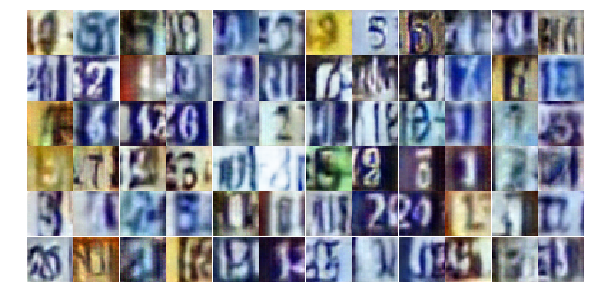

Epoch 11/25... Discriminator Loss: 0.4043... Generator Loss: 1.6688
Epoch 11/25... Discriminator Loss: 0.6303... Generator Loss: 1.0527
Epoch 11/25... Discriminator Loss: 0.8816... Generator Loss: 0.7925
Epoch 11/25... Discriminator Loss: 0.4938... Generator Loss: 1.4981
Epoch 11/25... Discriminator Loss: 0.8216... Generator Loss: 0.8123
Epoch 11/25... Discriminator Loss: 0.6778... Generator Loss: 0.9906
Epoch 11/25... Discriminator Loss: 0.4031... Generator Loss: 1.8620
Epoch 11/25... Discriminator Loss: 0.6361... Generator Loss: 2.3812
Epoch 11/25... Discriminator Loss: 1.8506... Generator Loss: 0.2420
Epoch 11/25... Discriminator Loss: 0.4260... Generator Loss: 1.7189


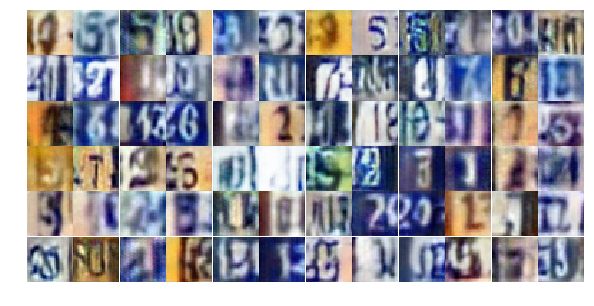

Epoch 11/25... Discriminator Loss: 0.7961... Generator Loss: 0.9492
Epoch 11/25... Discriminator Loss: 0.3629... Generator Loss: 1.7496
Epoch 11/25... Discriminator Loss: 0.7736... Generator Loss: 0.8623
Epoch 11/25... Discriminator Loss: 0.4701... Generator Loss: 1.3434
Epoch 11/25... Discriminator Loss: 2.5993... Generator Loss: 0.1277
Epoch 11/25... Discriminator Loss: 0.9727... Generator Loss: 0.9734
Epoch 11/25... Discriminator Loss: 0.8792... Generator Loss: 0.8447
Epoch 11/25... Discriminator Loss: 0.4509... Generator Loss: 1.7963
Epoch 11/25... Discriminator Loss: 0.9268... Generator Loss: 1.8176
Epoch 11/25... Discriminator Loss: 1.1378... Generator Loss: 0.6705


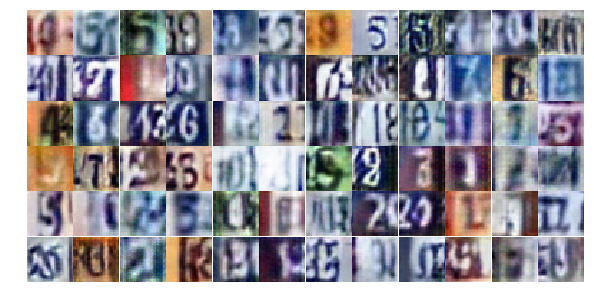

Epoch 12/25... Discriminator Loss: 0.7184... Generator Loss: 1.3489
Epoch 12/25... Discriminator Loss: 0.6184... Generator Loss: 1.3319
Epoch 12/25... Discriminator Loss: 0.7631... Generator Loss: 1.1865
Epoch 12/25... Discriminator Loss: 0.4850... Generator Loss: 1.6102
Epoch 12/25... Discriminator Loss: 0.4852... Generator Loss: 1.2775
Epoch 12/25... Discriminator Loss: 1.2905... Generator Loss: 0.4116
Epoch 12/25... Discriminator Loss: 0.5423... Generator Loss: 1.3435
Epoch 12/25... Discriminator Loss: 0.5462... Generator Loss: 1.7946
Epoch 12/25... Discriminator Loss: 0.7090... Generator Loss: 1.0014
Epoch 12/25... Discriminator Loss: 1.2116... Generator Loss: 0.4839


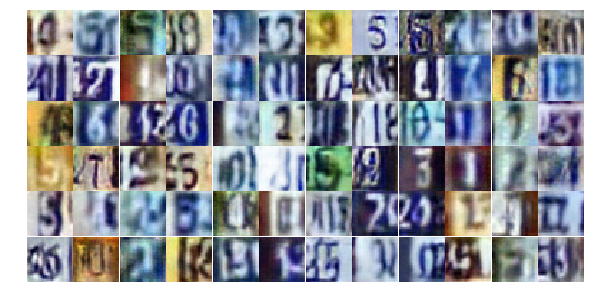

Epoch 12/25... Discriminator Loss: 0.4570... Generator Loss: 1.7646
Epoch 12/25... Discriminator Loss: 0.7931... Generator Loss: 0.8695
Epoch 12/25... Discriminator Loss: 0.4949... Generator Loss: 1.3266
Epoch 12/25... Discriminator Loss: 0.5122... Generator Loss: 1.7077
Epoch 12/25... Discriminator Loss: 0.4710... Generator Loss: 1.4921
Epoch 12/25... Discriminator Loss: 1.0011... Generator Loss: 0.6247
Epoch 12/25... Discriminator Loss: 1.3699... Generator Loss: 0.4043
Epoch 12/25... Discriminator Loss: 0.4264... Generator Loss: 1.8341
Epoch 12/25... Discriminator Loss: 0.6696... Generator Loss: 0.9523
Epoch 12/25... Discriminator Loss: 0.7319... Generator Loss: 0.8780


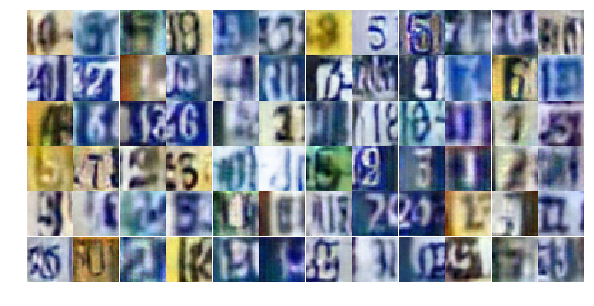

Epoch 12/25... Discriminator Loss: 0.3314... Generator Loss: 1.7686
Epoch 12/25... Discriminator Loss: 0.4915... Generator Loss: 1.3142
Epoch 12/25... Discriminator Loss: 0.5438... Generator Loss: 1.3299
Epoch 12/25... Discriminator Loss: 0.4361... Generator Loss: 1.6377
Epoch 12/25... Discriminator Loss: 0.4548... Generator Loss: 1.5373
Epoch 12/25... Discriminator Loss: 0.4915... Generator Loss: 1.8059
Epoch 12/25... Discriminator Loss: 0.6434... Generator Loss: 1.1471
Epoch 12/25... Discriminator Loss: 0.3238... Generator Loss: 1.6082
Epoch 12/25... Discriminator Loss: 0.6117... Generator Loss: 1.0997
Epoch 12/25... Discriminator Loss: 0.8874... Generator Loss: 0.7103


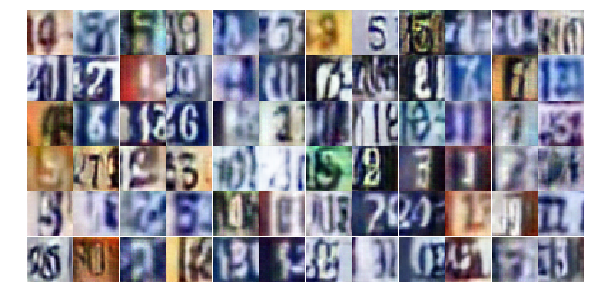

Epoch 12/25... Discriminator Loss: 0.4956... Generator Loss: 1.6089
Epoch 12/25... Discriminator Loss: 1.0338... Generator Loss: 0.6145
Epoch 12/25... Discriminator Loss: 0.8464... Generator Loss: 0.7565
Epoch 12/25... Discriminator Loss: 1.7391... Generator Loss: 0.2998
Epoch 12/25... Discriminator Loss: 0.6171... Generator Loss: 2.1651
Epoch 12/25... Discriminator Loss: 0.8587... Generator Loss: 2.1082
Epoch 12/25... Discriminator Loss: 1.0879... Generator Loss: 0.5489
Epoch 12/25... Discriminator Loss: 0.8228... Generator Loss: 0.8669
Epoch 12/25... Discriminator Loss: 0.6539... Generator Loss: 1.1556
Epoch 12/25... Discriminator Loss: 0.3315... Generator Loss: 1.6445


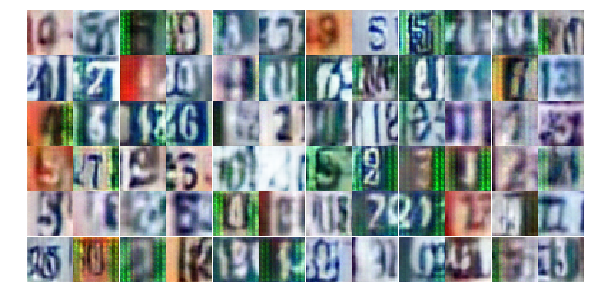

Epoch 12/25... Discriminator Loss: 0.6191... Generator Loss: 1.1321
Epoch 12/25... Discriminator Loss: 0.4040... Generator Loss: 1.4909
Epoch 12/25... Discriminator Loss: 0.3831... Generator Loss: 1.5185
Epoch 12/25... Discriminator Loss: 0.6999... Generator Loss: 0.9861
Epoch 12/25... Discriminator Loss: 0.6518... Generator Loss: 1.6128
Epoch 12/25... Discriminator Loss: 1.1850... Generator Loss: 0.4959
Epoch 12/25... Discriminator Loss: 0.7114... Generator Loss: 0.9458
Epoch 12/25... Discriminator Loss: 0.6012... Generator Loss: 1.6136
Epoch 12/25... Discriminator Loss: 0.6469... Generator Loss: 1.0632
Epoch 12/25... Discriminator Loss: 0.6138... Generator Loss: 1.0256


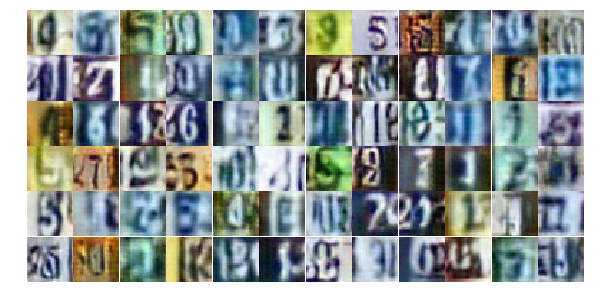

Epoch 12/25... Discriminator Loss: 0.9117... Generator Loss: 0.7570
Epoch 12/25... Discriminator Loss: 0.4442... Generator Loss: 1.3910
Epoch 12/25... Discriminator Loss: 0.4978... Generator Loss: 1.3244
Epoch 12/25... Discriminator Loss: 2.1407... Generator Loss: 0.1835
Epoch 12/25... Discriminator Loss: 0.4764... Generator Loss: 1.6062
Epoch 12/25... Discriminator Loss: 1.0514... Generator Loss: 3.4936
Epoch 12/25... Discriminator Loss: 1.5542... Generator Loss: 0.3475
Epoch 13/25... Discriminator Loss: 0.5210... Generator Loss: 1.3939
Epoch 13/25... Discriminator Loss: 0.4318... Generator Loss: 1.6157
Epoch 13/25... Discriminator Loss: 0.8400... Generator Loss: 0.8416


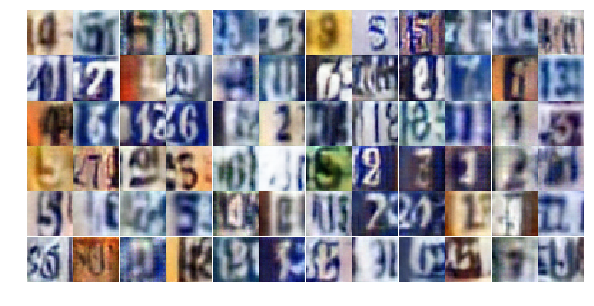

Epoch 13/25... Discriminator Loss: 0.5502... Generator Loss: 1.2494
Epoch 13/25... Discriminator Loss: 0.3483... Generator Loss: 1.9911
Epoch 13/25... Discriminator Loss: 0.8558... Generator Loss: 1.4262
Epoch 13/25... Discriminator Loss: 0.7779... Generator Loss: 1.0744
Epoch 13/25... Discriminator Loss: 0.7338... Generator Loss: 0.9626
Epoch 13/25... Discriminator Loss: 0.5807... Generator Loss: 1.1317
Epoch 13/25... Discriminator Loss: 0.4042... Generator Loss: 1.8079
Epoch 13/25... Discriminator Loss: 0.7122... Generator Loss: 0.9490
Epoch 13/25... Discriminator Loss: 0.5123... Generator Loss: 1.3667
Epoch 13/25... Discriminator Loss: 1.1155... Generator Loss: 3.8249


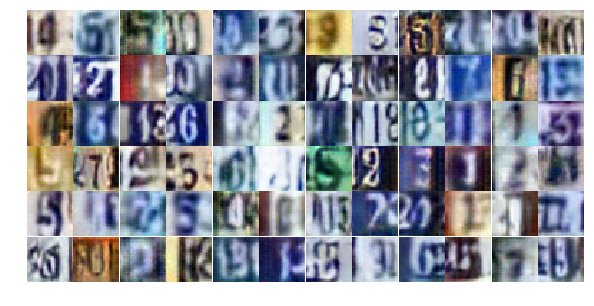

Epoch 13/25... Discriminator Loss: 0.7754... Generator Loss: 1.7745
Epoch 13/25... Discriminator Loss: 0.4040... Generator Loss: 1.6226
Epoch 13/25... Discriminator Loss: 1.0305... Generator Loss: 0.6591
Epoch 13/25... Discriminator Loss: 0.5684... Generator Loss: 1.3042
Epoch 13/25... Discriminator Loss: 0.5698... Generator Loss: 1.8318
Epoch 13/25... Discriminator Loss: 0.7360... Generator Loss: 1.4851
Epoch 13/25... Discriminator Loss: 0.7315... Generator Loss: 1.0551
Epoch 13/25... Discriminator Loss: 0.8893... Generator Loss: 0.7727
Epoch 13/25... Discriminator Loss: 0.5764... Generator Loss: 1.0984
Epoch 13/25... Discriminator Loss: 0.6858... Generator Loss: 0.9625


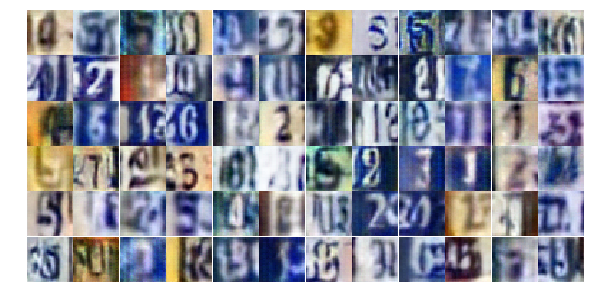

Epoch 13/25... Discriminator Loss: 0.8162... Generator Loss: 0.8160
Epoch 13/25... Discriminator Loss: 0.6383... Generator Loss: 1.2629
Epoch 13/25... Discriminator Loss: 0.8803... Generator Loss: 3.2330
Epoch 13/25... Discriminator Loss: 0.6996... Generator Loss: 0.9768
Epoch 13/25... Discriminator Loss: 0.5502... Generator Loss: 1.3650
Epoch 13/25... Discriminator Loss: 0.7240... Generator Loss: 0.9792
Epoch 13/25... Discriminator Loss: 0.8399... Generator Loss: 1.9500
Epoch 13/25... Discriminator Loss: 0.6531... Generator Loss: 1.2098
Epoch 13/25... Discriminator Loss: 0.8067... Generator Loss: 0.8318
Epoch 13/25... Discriminator Loss: 0.5687... Generator Loss: 1.4409


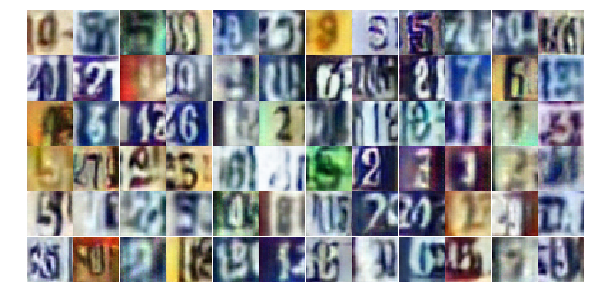

Epoch 13/25... Discriminator Loss: 1.0594... Generator Loss: 0.6069
Epoch 13/25... Discriminator Loss: 0.8143... Generator Loss: 0.9934
Epoch 13/25... Discriminator Loss: 0.9735... Generator Loss: 0.6891
Epoch 13/25... Discriminator Loss: 1.7414... Generator Loss: 0.2912
Epoch 13/25... Discriminator Loss: 0.5282... Generator Loss: 1.2548
Epoch 13/25... Discriminator Loss: 0.5418... Generator Loss: 1.2444
Epoch 13/25... Discriminator Loss: 0.5749... Generator Loss: 1.1036
Epoch 13/25... Discriminator Loss: 0.8228... Generator Loss: 0.9806
Epoch 13/25... Discriminator Loss: 0.5071... Generator Loss: 1.6602
Epoch 13/25... Discriminator Loss: 0.5258... Generator Loss: 1.3310


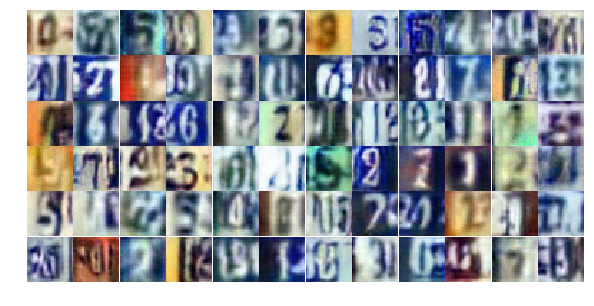

Epoch 13/25... Discriminator Loss: 0.5681... Generator Loss: 1.2178
Epoch 13/25... Discriminator Loss: 2.9220... Generator Loss: 2.2424
Epoch 13/25... Discriminator Loss: 0.8997... Generator Loss: 1.0322
Epoch 13/25... Discriminator Loss: 0.6613... Generator Loss: 1.1443
Epoch 13/25... Discriminator Loss: 1.2043... Generator Loss: 0.5669
Epoch 13/25... Discriminator Loss: 0.8248... Generator Loss: 0.9472
Epoch 13/25... Discriminator Loss: 0.6122... Generator Loss: 1.2631
Epoch 13/25... Discriminator Loss: 0.7490... Generator Loss: 0.8724
Epoch 13/25... Discriminator Loss: 0.4560... Generator Loss: 1.3011
Epoch 13/25... Discriminator Loss: 0.6464... Generator Loss: 1.1057


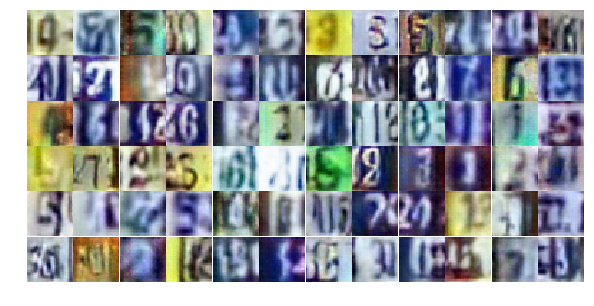

Epoch 13/25... Discriminator Loss: 0.4164... Generator Loss: 1.8655
Epoch 13/25... Discriminator Loss: 0.9664... Generator Loss: 0.7617
Epoch 13/25... Discriminator Loss: 0.5267... Generator Loss: 1.3414
Epoch 13/25... Discriminator Loss: 0.8268... Generator Loss: 0.8326
Epoch 14/25... Discriminator Loss: 1.3795... Generator Loss: 0.4235
Epoch 14/25... Discriminator Loss: 0.6047... Generator Loss: 1.1298
Epoch 14/25... Discriminator Loss: 0.9607... Generator Loss: 0.6940
Epoch 14/25... Discriminator Loss: 0.5397... Generator Loss: 1.2105
Epoch 14/25... Discriminator Loss: 0.5131... Generator Loss: 1.3012
Epoch 14/25... Discriminator Loss: 0.9438... Generator Loss: 0.6753


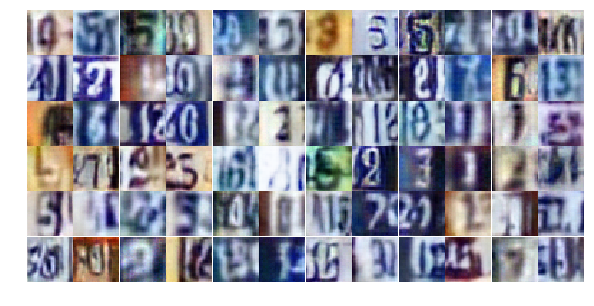

Epoch 14/25... Discriminator Loss: 1.3671... Generator Loss: 3.6255
Epoch 14/25... Discriminator Loss: 0.5842... Generator Loss: 1.9467
Epoch 14/25... Discriminator Loss: 0.8447... Generator Loss: 0.8697
Epoch 14/25... Discriminator Loss: 0.5852... Generator Loss: 1.1622
Epoch 14/25... Discriminator Loss: 1.0035... Generator Loss: 0.5890
Epoch 14/25... Discriminator Loss: 0.4230... Generator Loss: 1.3751
Epoch 14/25... Discriminator Loss: 0.4992... Generator Loss: 2.0374
Epoch 14/25... Discriminator Loss: 1.5136... Generator Loss: 0.3541
Epoch 14/25... Discriminator Loss: 1.2574... Generator Loss: 0.4459
Epoch 14/25... Discriminator Loss: 1.4193... Generator Loss: 0.3925


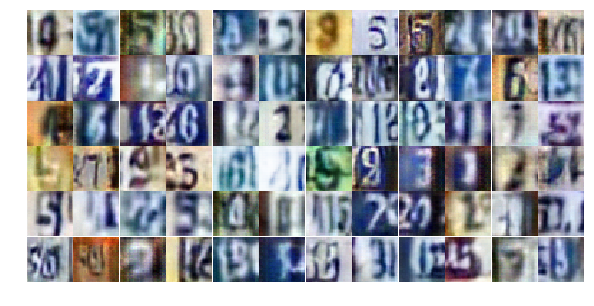

Epoch 14/25... Discriminator Loss: 0.4574... Generator Loss: 1.5066
Epoch 14/25... Discriminator Loss: 0.7209... Generator Loss: 2.8285
Epoch 14/25... Discriminator Loss: 0.7513... Generator Loss: 1.0716
Epoch 14/25... Discriminator Loss: 0.5276... Generator Loss: 1.2608
Epoch 14/25... Discriminator Loss: 1.0872... Generator Loss: 0.5981
Epoch 14/25... Discriminator Loss: 0.6515... Generator Loss: 1.1579
Epoch 14/25... Discriminator Loss: 0.6291... Generator Loss: 1.2489
Epoch 14/25... Discriminator Loss: 0.4642... Generator Loss: 1.3819
Epoch 14/25... Discriminator Loss: 0.5213... Generator Loss: 1.2713
Epoch 14/25... Discriminator Loss: 0.5567... Generator Loss: 1.1084


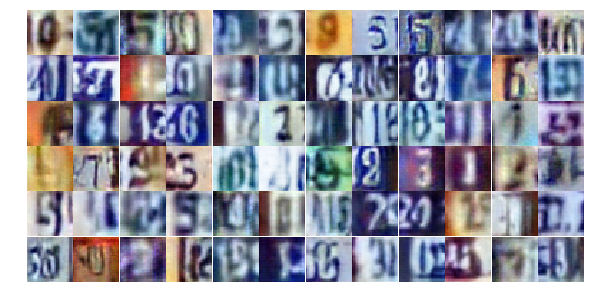

Epoch 14/25... Discriminator Loss: 1.1108... Generator Loss: 0.5563
Epoch 14/25... Discriminator Loss: 0.5238... Generator Loss: 1.2081
Epoch 14/25... Discriminator Loss: 0.5057... Generator Loss: 1.3543
Epoch 14/25... Discriminator Loss: 0.8071... Generator Loss: 0.9946
Epoch 14/25... Discriminator Loss: 0.7805... Generator Loss: 1.0089
Epoch 14/25... Discriminator Loss: 0.7371... Generator Loss: 1.0288
Epoch 14/25... Discriminator Loss: 0.9115... Generator Loss: 0.7691
Epoch 14/25... Discriminator Loss: 0.4846... Generator Loss: 1.4019
Epoch 14/25... Discriminator Loss: 0.4735... Generator Loss: 1.4092
Epoch 14/25... Discriminator Loss: 0.7819... Generator Loss: 0.8649


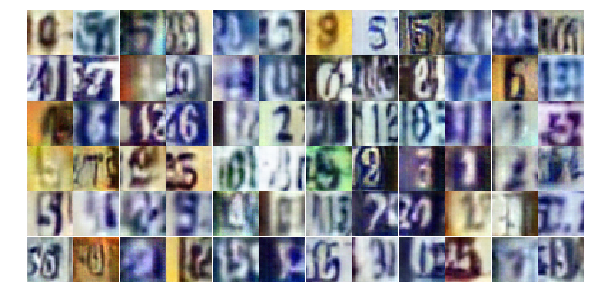

Epoch 14/25... Discriminator Loss: 1.2022... Generator Loss: 0.4921
Epoch 14/25... Discriminator Loss: 0.7743... Generator Loss: 0.8992
Epoch 14/25... Discriminator Loss: 0.9352... Generator Loss: 0.7215
Epoch 14/25... Discriminator Loss: 0.7204... Generator Loss: 0.9012
Epoch 14/25... Discriminator Loss: 0.9433... Generator Loss: 0.6859
Epoch 14/25... Discriminator Loss: 0.7360... Generator Loss: 0.9489
Epoch 14/25... Discriminator Loss: 0.6079... Generator Loss: 1.1538
Epoch 14/25... Discriminator Loss: 0.5184... Generator Loss: 1.2437
Epoch 14/25... Discriminator Loss: 0.9260... Generator Loss: 0.7593
Epoch 14/25... Discriminator Loss: 0.9930... Generator Loss: 0.6226


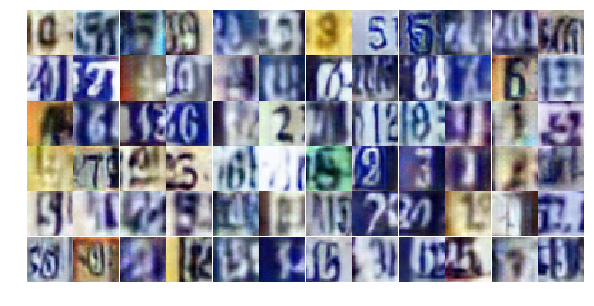

Epoch 14/25... Discriminator Loss: 0.8251... Generator Loss: 0.8439
Epoch 14/25... Discriminator Loss: 1.2224... Generator Loss: 0.5123
Epoch 14/25... Discriminator Loss: 0.5807... Generator Loss: 1.1573
Epoch 14/25... Discriminator Loss: 0.8967... Generator Loss: 0.7332
Epoch 14/25... Discriminator Loss: 0.6663... Generator Loss: 0.9993
Epoch 14/25... Discriminator Loss: 0.6206... Generator Loss: 1.1321
Epoch 14/25... Discriminator Loss: 0.6307... Generator Loss: 1.0978
Epoch 14/25... Discriminator Loss: 0.5063... Generator Loss: 2.0049
Epoch 14/25... Discriminator Loss: 1.1196... Generator Loss: 0.5465
Epoch 14/25... Discriminator Loss: 0.6580... Generator Loss: 1.0436


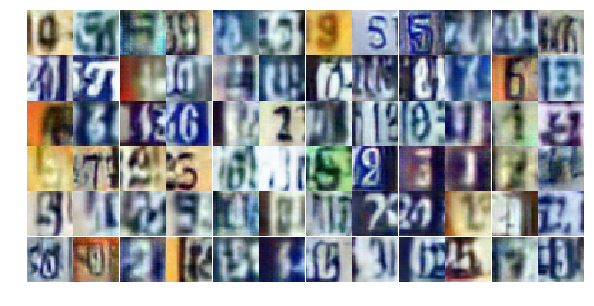

Epoch 14/25... Discriminator Loss: 0.7882... Generator Loss: 0.8862
Epoch 14/25... Discriminator Loss: 1.0543... Generator Loss: 0.6381
Epoch 15/25... Discriminator Loss: 0.6528... Generator Loss: 1.1019
Epoch 15/25... Discriminator Loss: 0.5157... Generator Loss: 1.4208
Epoch 15/25... Discriminator Loss: 0.4969... Generator Loss: 1.3902
Epoch 15/25... Discriminator Loss: 0.5820... Generator Loss: 1.1327
Epoch 15/25... Discriminator Loss: 0.7788... Generator Loss: 0.7951
Epoch 15/25... Discriminator Loss: 0.4419... Generator Loss: 1.7418
Epoch 15/25... Discriminator Loss: 3.5901... Generator Loss: 0.0786
Epoch 15/25... Discriminator Loss: 0.6504... Generator Loss: 1.3692


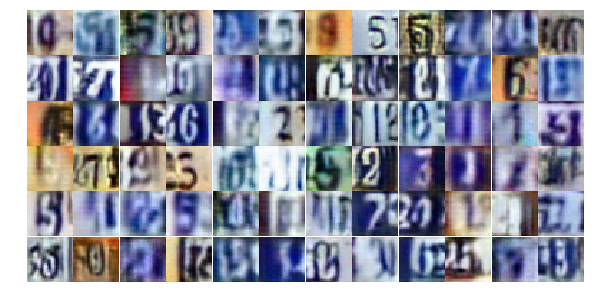

Epoch 15/25... Discriminator Loss: 0.6231... Generator Loss: 1.4415
Epoch 15/25... Discriminator Loss: 0.7537... Generator Loss: 1.5659
Epoch 15/25... Discriminator Loss: 1.0320... Generator Loss: 0.7251
Epoch 15/25... Discriminator Loss: 0.7417... Generator Loss: 0.9507
Epoch 15/25... Discriminator Loss: 1.0005... Generator Loss: 0.6918
Epoch 15/25... Discriminator Loss: 0.4156... Generator Loss: 1.5004
Epoch 15/25... Discriminator Loss: 0.7249... Generator Loss: 0.9298
Epoch 15/25... Discriminator Loss: 0.8020... Generator Loss: 0.8345
Epoch 15/25... Discriminator Loss: 0.5743... Generator Loss: 3.1639
Epoch 15/25... Discriminator Loss: 0.9612... Generator Loss: 0.8101


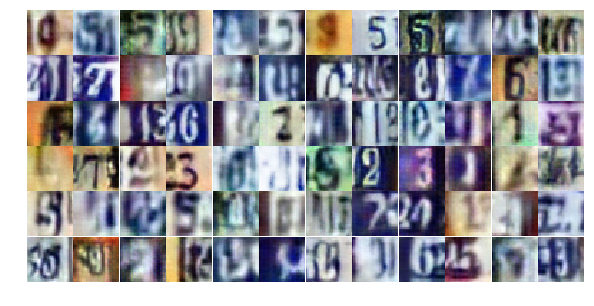

Epoch 15/25... Discriminator Loss: 0.7739... Generator Loss: 0.9307
Epoch 15/25... Discriminator Loss: 0.4871... Generator Loss: 1.1992
Epoch 15/25... Discriminator Loss: 0.5147... Generator Loss: 1.4425
Epoch 15/25... Discriminator Loss: 1.2557... Generator Loss: 0.5371
Epoch 15/25... Discriminator Loss: 0.9779... Generator Loss: 0.6600
Epoch 15/25... Discriminator Loss: 0.5262... Generator Loss: 1.3147
Epoch 15/25... Discriminator Loss: 0.9643... Generator Loss: 0.7418
Epoch 15/25... Discriminator Loss: 0.7850... Generator Loss: 0.8455
Epoch 15/25... Discriminator Loss: 0.5404... Generator Loss: 1.1998
Epoch 15/25... Discriminator Loss: 1.2567... Generator Loss: 0.4907


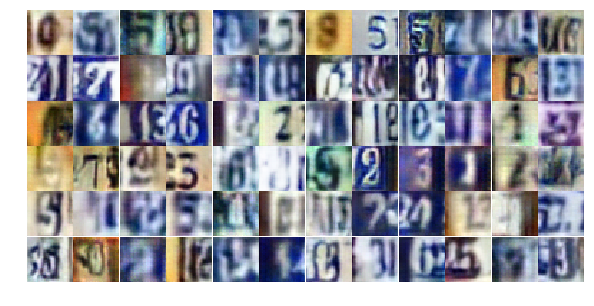

Epoch 15/25... Discriminator Loss: 0.6203... Generator Loss: 1.0911
Epoch 15/25... Discriminator Loss: 0.8764... Generator Loss: 0.7989
Epoch 15/25... Discriminator Loss: 0.3896... Generator Loss: 1.3897
Epoch 15/25... Discriminator Loss: 0.7184... Generator Loss: 1.0028
Epoch 15/25... Discriminator Loss: 0.5671... Generator Loss: 1.4616
Epoch 15/25... Discriminator Loss: 1.1773... Generator Loss: 2.6175
Epoch 15/25... Discriminator Loss: 0.4539... Generator Loss: 1.3867
Epoch 15/25... Discriminator Loss: 0.6196... Generator Loss: 1.1090
Epoch 15/25... Discriminator Loss: 0.3976... Generator Loss: 1.5758
Epoch 15/25... Discriminator Loss: 0.9409... Generator Loss: 0.7570


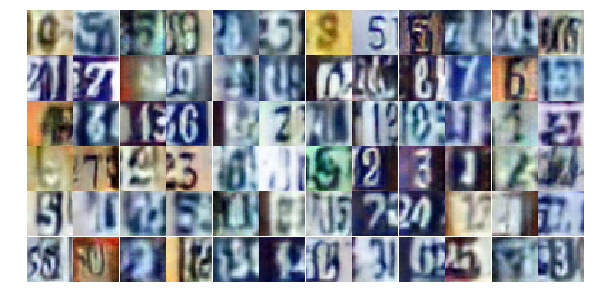

Epoch 15/25... Discriminator Loss: 0.8065... Generator Loss: 0.8504
Epoch 15/25... Discriminator Loss: 1.5302... Generator Loss: 0.3549
Epoch 15/25... Discriminator Loss: 0.5554... Generator Loss: 1.1622
Epoch 15/25... Discriminator Loss: 0.6110... Generator Loss: 1.1619
Epoch 15/25... Discriminator Loss: 0.6654... Generator Loss: 0.9699
Epoch 15/25... Discriminator Loss: 1.7698... Generator Loss: 0.2933
Epoch 15/25... Discriminator Loss: 0.4710... Generator Loss: 1.4519
Epoch 15/25... Discriminator Loss: 0.9181... Generator Loss: 0.7444
Epoch 15/25... Discriminator Loss: 0.9118... Generator Loss: 0.7600
Epoch 15/25... Discriminator Loss: 0.8134... Generator Loss: 1.2891


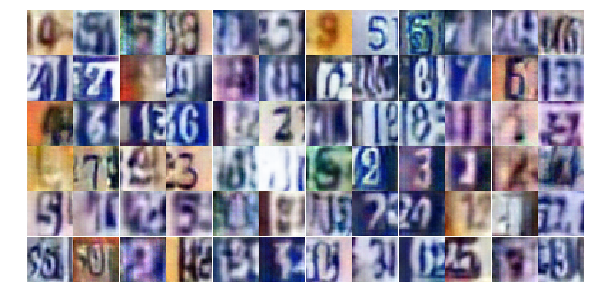

Epoch 15/25... Discriminator Loss: 0.8598... Generator Loss: 0.7718
Epoch 15/25... Discriminator Loss: 1.2069... Generator Loss: 0.5357
Epoch 15/25... Discriminator Loss: 0.3739... Generator Loss: 1.8787
Epoch 15/25... Discriminator Loss: 0.5876... Generator Loss: 1.4780
Epoch 15/25... Discriminator Loss: 0.3804... Generator Loss: 1.7318
Epoch 15/25... Discriminator Loss: 2.7773... Generator Loss: 4.6217
Epoch 15/25... Discriminator Loss: 1.5866... Generator Loss: 0.4345
Epoch 15/25... Discriminator Loss: 0.6136... Generator Loss: 1.3319
Epoch 15/25... Discriminator Loss: 1.5957... Generator Loss: 0.3708
Epoch 16/25... Discriminator Loss: 0.8928... Generator Loss: 0.7812


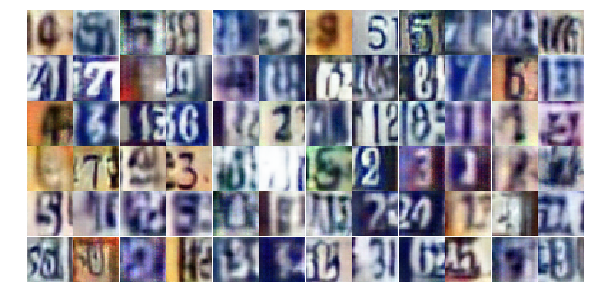

Epoch 16/25... Discriminator Loss: 0.6540... Generator Loss: 1.1894
Epoch 16/25... Discriminator Loss: 0.7357... Generator Loss: 1.0109
Epoch 16/25... Discriminator Loss: 0.9085... Generator Loss: 0.8160
Epoch 16/25... Discriminator Loss: 0.6657... Generator Loss: 1.0371
Epoch 16/25... Discriminator Loss: 0.5712... Generator Loss: 1.4462
Epoch 16/25... Discriminator Loss: 0.6371... Generator Loss: 1.6289
Epoch 16/25... Discriminator Loss: 1.7915... Generator Loss: 0.2532
Epoch 16/25... Discriminator Loss: 1.2586... Generator Loss: 0.4944
Epoch 16/25... Discriminator Loss: 0.4651... Generator Loss: 1.3632
Epoch 16/25... Discriminator Loss: 0.5463... Generator Loss: 1.2173


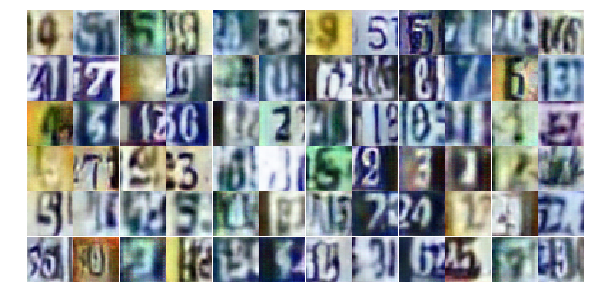

Epoch 16/25... Discriminator Loss: 0.8848... Generator Loss: 0.7233
Epoch 16/25... Discriminator Loss: 0.6503... Generator Loss: 1.0355
Epoch 16/25... Discriminator Loss: 0.8120... Generator Loss: 0.8723
Epoch 16/25... Discriminator Loss: 1.5460... Generator Loss: 0.3151
Epoch 16/25... Discriminator Loss: 0.6563... Generator Loss: 2.7420
Epoch 16/25... Discriminator Loss: 0.6481... Generator Loss: 1.0936
Epoch 16/25... Discriminator Loss: 1.6300... Generator Loss: 1.1907
Epoch 16/25... Discriminator Loss: 0.4676... Generator Loss: 1.5123
Epoch 16/25... Discriminator Loss: 0.6152... Generator Loss: 1.1674
Epoch 16/25... Discriminator Loss: 0.5368... Generator Loss: 1.2961


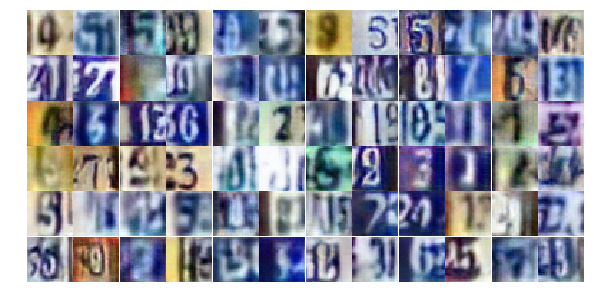

Epoch 16/25... Discriminator Loss: 0.6934... Generator Loss: 1.2189
Epoch 16/25... Discriminator Loss: 0.8633... Generator Loss: 0.8496
Epoch 16/25... Discriminator Loss: 0.7413... Generator Loss: 0.8999
Epoch 16/25... Discriminator Loss: 1.0041... Generator Loss: 0.6266
Epoch 16/25... Discriminator Loss: 0.5557... Generator Loss: 1.4523
Epoch 16/25... Discriminator Loss: 1.2267... Generator Loss: 0.4861
Epoch 16/25... Discriminator Loss: 0.7499... Generator Loss: 0.8625
Epoch 16/25... Discriminator Loss: 0.5787... Generator Loss: 1.1797
Epoch 16/25... Discriminator Loss: 0.9100... Generator Loss: 0.7571
Epoch 16/25... Discriminator Loss: 0.5827... Generator Loss: 1.1819


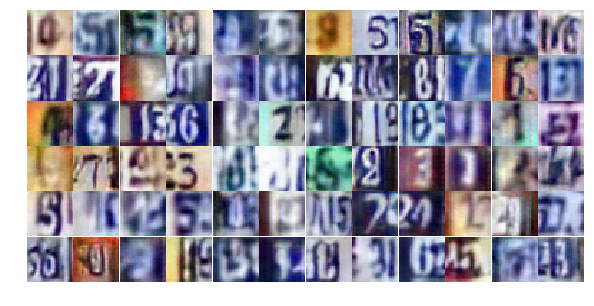

Epoch 16/25... Discriminator Loss: 0.6862... Generator Loss: 0.9236
Epoch 16/25... Discriminator Loss: 0.5820... Generator Loss: 1.1738
Epoch 16/25... Discriminator Loss: 0.8037... Generator Loss: 0.7925
Epoch 16/25... Discriminator Loss: 0.6174... Generator Loss: 1.2475
Epoch 16/25... Discriminator Loss: 0.8226... Generator Loss: 0.9638
Epoch 16/25... Discriminator Loss: 0.6869... Generator Loss: 2.1487
Epoch 16/25... Discriminator Loss: 0.6352... Generator Loss: 1.0413
Epoch 16/25... Discriminator Loss: 1.0221... Generator Loss: 0.6052
Epoch 16/25... Discriminator Loss: 0.5215... Generator Loss: 1.2568
Epoch 16/25... Discriminator Loss: 0.4694... Generator Loss: 1.5710


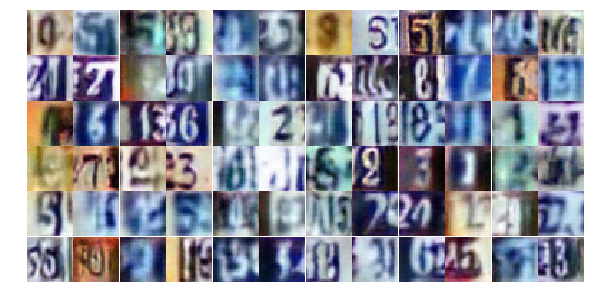

Epoch 16/25... Discriminator Loss: 0.5654... Generator Loss: 1.1807
Epoch 16/25... Discriminator Loss: 0.4603... Generator Loss: 1.6052
Epoch 16/25... Discriminator Loss: 1.6082... Generator Loss: 0.4286
Epoch 16/25... Discriminator Loss: 0.8465... Generator Loss: 1.1381
Epoch 16/25... Discriminator Loss: 0.7780... Generator Loss: 1.3289
Epoch 16/25... Discriminator Loss: 0.8434... Generator Loss: 0.8322
Epoch 16/25... Discriminator Loss: 0.4124... Generator Loss: 1.6883
Epoch 16/25... Discriminator Loss: 1.0954... Generator Loss: 0.5368
Epoch 16/25... Discriminator Loss: 0.4421... Generator Loss: 1.3087
Epoch 16/25... Discriminator Loss: 1.2130... Generator Loss: 0.4952


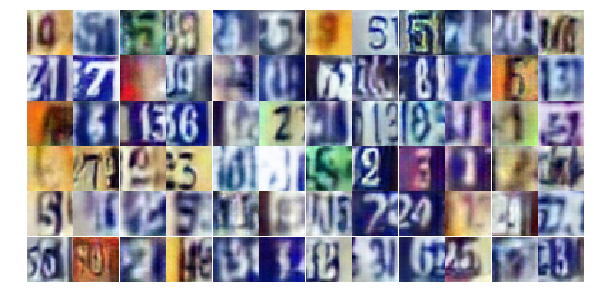

Epoch 16/25... Discriminator Loss: 1.4836... Generator Loss: 0.3641
Epoch 16/25... Discriminator Loss: 0.6363... Generator Loss: 1.8857
Epoch 16/25... Discriminator Loss: 1.8005... Generator Loss: 0.2850
Epoch 16/25... Discriminator Loss: 0.5257... Generator Loss: 1.2027
Epoch 16/25... Discriminator Loss: 1.0286... Generator Loss: 0.6003
Epoch 16/25... Discriminator Loss: 1.0198... Generator Loss: 2.8458
Epoch 17/25... Discriminator Loss: 0.5476... Generator Loss: 1.2652
Epoch 17/25... Discriminator Loss: 0.7983... Generator Loss: 0.8581
Epoch 17/25... Discriminator Loss: 0.7649... Generator Loss: 1.0316
Epoch 17/25... Discriminator Loss: 0.6451... Generator Loss: 1.0690


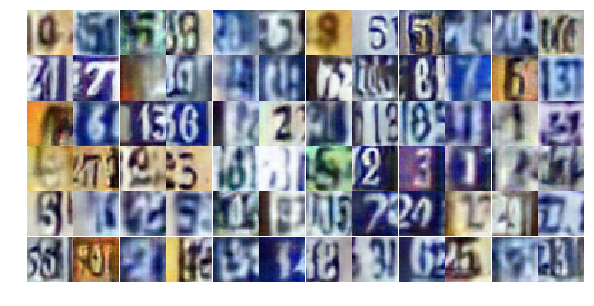

Epoch 17/25... Discriminator Loss: 0.5862... Generator Loss: 1.1296
Epoch 17/25... Discriminator Loss: 1.0452... Generator Loss: 0.6316
Epoch 17/25... Discriminator Loss: 1.1304... Generator Loss: 0.5567
Epoch 17/25... Discriminator Loss: 0.8792... Generator Loss: 0.7789
Epoch 17/25... Discriminator Loss: 0.8712... Generator Loss: 0.8252
Epoch 17/25... Discriminator Loss: 0.9775... Generator Loss: 0.6437
Epoch 17/25... Discriminator Loss: 0.7330... Generator Loss: 2.2332
Epoch 17/25... Discriminator Loss: 0.4887... Generator Loss: 1.4344
Epoch 17/25... Discriminator Loss: 0.4380... Generator Loss: 1.5456
Epoch 17/25... Discriminator Loss: 0.5956... Generator Loss: 1.5417


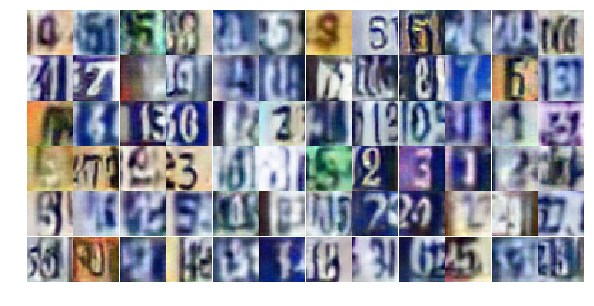

Epoch 17/25... Discriminator Loss: 0.9923... Generator Loss: 1.8850
Epoch 17/25... Discriminator Loss: 0.7390... Generator Loss: 0.8822
Epoch 17/25... Discriminator Loss: 0.5599... Generator Loss: 1.2073
Epoch 17/25... Discriminator Loss: 1.4624... Generator Loss: 0.3863
Epoch 17/25... Discriminator Loss: 0.6578... Generator Loss: 1.8659
Epoch 17/25... Discriminator Loss: 0.9519... Generator Loss: 0.7768
Epoch 17/25... Discriminator Loss: 0.5006... Generator Loss: 1.4121
Epoch 17/25... Discriminator Loss: 0.4101... Generator Loss: 1.8235
Epoch 17/25... Discriminator Loss: 0.7582... Generator Loss: 0.9677
Epoch 17/25... Discriminator Loss: 0.6637... Generator Loss: 0.9797


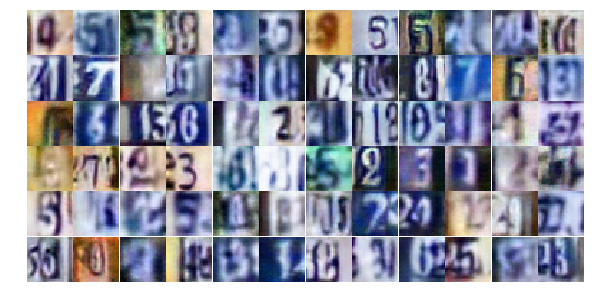

Epoch 17/25... Discriminator Loss: 1.9032... Generator Loss: 0.2819
Epoch 17/25... Discriminator Loss: 0.6805... Generator Loss: 1.0131
Epoch 17/25... Discriminator Loss: 0.4056... Generator Loss: 1.5713
Epoch 17/25... Discriminator Loss: 1.4331... Generator Loss: 0.3773
Epoch 17/25... Discriminator Loss: 1.3382... Generator Loss: 0.4470
Epoch 17/25... Discriminator Loss: 0.5600... Generator Loss: 1.1397
Epoch 17/25... Discriminator Loss: 0.8537... Generator Loss: 0.7911
Epoch 17/25... Discriminator Loss: 0.9480... Generator Loss: 0.7443
Epoch 17/25... Discriminator Loss: 1.0895... Generator Loss: 0.6747
Epoch 17/25... Discriminator Loss: 0.3340... Generator Loss: 1.9575


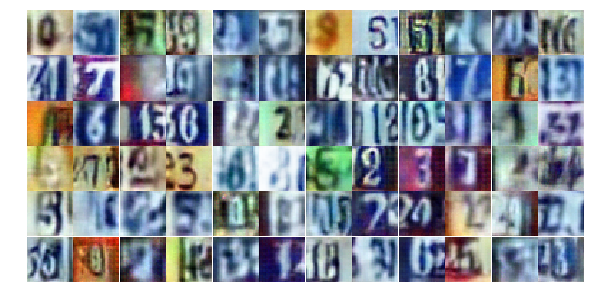

Epoch 17/25... Discriminator Loss: 0.3864... Generator Loss: 1.9287
Epoch 17/25... Discriminator Loss: 1.1146... Generator Loss: 0.7040
Epoch 17/25... Discriminator Loss: 0.5756... Generator Loss: 1.3794
Epoch 17/25... Discriminator Loss: 0.7550... Generator Loss: 1.2725
Epoch 17/25... Discriminator Loss: 1.3309... Generator Loss: 0.4354
Epoch 17/25... Discriminator Loss: 0.9089... Generator Loss: 0.6993
Epoch 17/25... Discriminator Loss: 0.8336... Generator Loss: 0.9293
Epoch 17/25... Discriminator Loss: 0.5321... Generator Loss: 1.3580
Epoch 17/25... Discriminator Loss: 0.3180... Generator Loss: 1.7587
Epoch 17/25... Discriminator Loss: 0.5640... Generator Loss: 1.1606


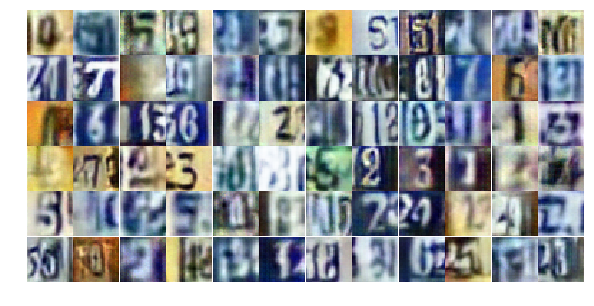

Epoch 17/25... Discriminator Loss: 1.2575... Generator Loss: 0.4893
Epoch 17/25... Discriminator Loss: 0.2881... Generator Loss: 1.9793
Epoch 17/25... Discriminator Loss: 0.6636... Generator Loss: 2.1587
Epoch 17/25... Discriminator Loss: 0.3484... Generator Loss: 1.6902
Epoch 17/25... Discriminator Loss: 0.7491... Generator Loss: 0.9622
Epoch 17/25... Discriminator Loss: 0.7241... Generator Loss: 1.1532
Epoch 17/25... Discriminator Loss: 1.1628... Generator Loss: 0.4874
Epoch 17/25... Discriminator Loss: 0.5878... Generator Loss: 1.2206
Epoch 17/25... Discriminator Loss: 0.5231... Generator Loss: 1.3972
Epoch 17/25... Discriminator Loss: 1.1843... Generator Loss: 0.5468


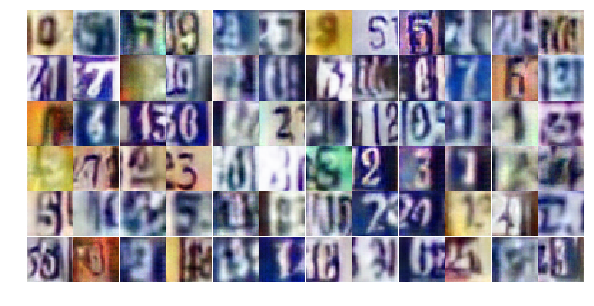

Epoch 17/25... Discriminator Loss: 1.0435... Generator Loss: 0.6589
Epoch 17/25... Discriminator Loss: 0.6353... Generator Loss: 1.6097
Epoch 17/25... Discriminator Loss: 0.4176... Generator Loss: 1.9495
Epoch 17/25... Discriminator Loss: 0.7431... Generator Loss: 0.9677
Epoch 18/25... Discriminator Loss: 0.7892... Generator Loss: 0.8850
Epoch 18/25... Discriminator Loss: 1.1235... Generator Loss: 0.5281
Epoch 18/25... Discriminator Loss: 0.6130... Generator Loss: 1.1067
Epoch 18/25... Discriminator Loss: 0.6856... Generator Loss: 1.0269
Epoch 18/25... Discriminator Loss: 1.0012... Generator Loss: 0.6718
Epoch 18/25... Discriminator Loss: 0.4825... Generator Loss: 1.4337


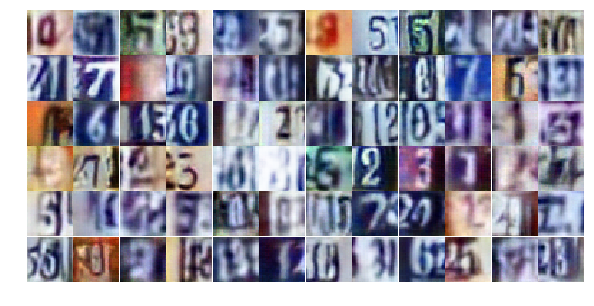

Epoch 18/25... Discriminator Loss: 0.3657... Generator Loss: 2.6979
Epoch 18/25... Discriminator Loss: 0.9982... Generator Loss: 0.7020
Epoch 18/25... Discriminator Loss: 1.0136... Generator Loss: 0.5921
Epoch 18/25... Discriminator Loss: 0.3234... Generator Loss: 2.0868
Epoch 18/25... Discriminator Loss: 0.5900... Generator Loss: 1.0540
Epoch 18/25... Discriminator Loss: 1.2736... Generator Loss: 0.4294
Epoch 18/25... Discriminator Loss: 0.7611... Generator Loss: 3.6600
Epoch 18/25... Discriminator Loss: 1.8588... Generator Loss: 1.0914
Epoch 18/25... Discriminator Loss: 0.6733... Generator Loss: 1.6170
Epoch 18/25... Discriminator Loss: 0.4008... Generator Loss: 1.9484


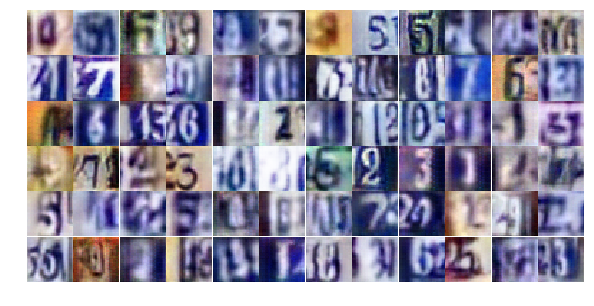

Epoch 18/25... Discriminator Loss: 0.6558... Generator Loss: 1.1930
Epoch 18/25... Discriminator Loss: 0.8661... Generator Loss: 0.7951
Epoch 18/25... Discriminator Loss: 1.1005... Generator Loss: 0.6113
Epoch 18/25... Discriminator Loss: 0.6385... Generator Loss: 1.1665
Epoch 18/25... Discriminator Loss: 0.6077... Generator Loss: 1.1228
Epoch 18/25... Discriminator Loss: 0.8117... Generator Loss: 0.7924
Epoch 18/25... Discriminator Loss: 0.9505... Generator Loss: 0.7685
Epoch 18/25... Discriminator Loss: 0.9089... Generator Loss: 0.7674
Epoch 18/25... Discriminator Loss: 0.5735... Generator Loss: 1.1664
Epoch 18/25... Discriminator Loss: 0.9791... Generator Loss: 0.7080


In [ ]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

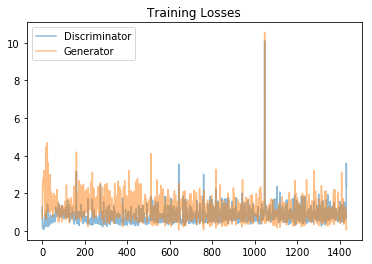

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

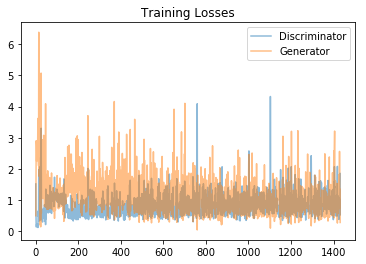

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

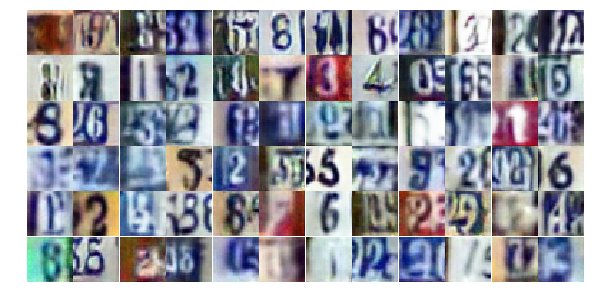

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

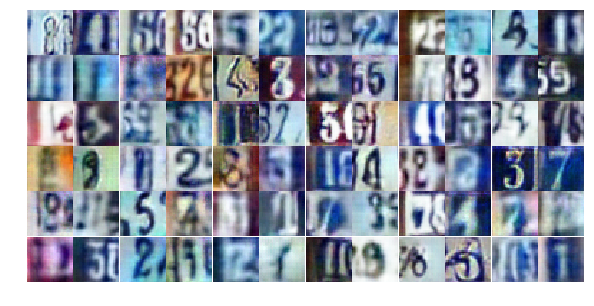

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))